In [38]:
import json
import os 
from PIL import Image
import cv2 as cv2
import numpy as np
import math
import imutils


import matplotlib.pyplot as plt
%matplotlib inline

In [25]:
def getTranslationMatrix2d(dx, dy):
    """
    Returns a numpy affine transformation matrix for a 2D translation of
    (dx, dy)
    """
    return np.matrix([[1, 0, dx], [0, 1, dy], [0, 0, 1]])


def rotateImage(image, angle):
    """
    Rotates the given image about it's centre
    """

    image_size = (image.shape[1], image.shape[0])
    image_center = tuple(np.array(image_size) / 2)

    rot_mat = np.vstack([cv2.getRotationMatrix2D(image_center, angle, 1.0), [0, 0, 1]])
    trans_mat = np.identity(3)

    w2 = image_size[0] * 0.5
    h2 = image_size[1] * 0.5

    rot_mat_notranslate = np.matrix(rot_mat[0:2, 0:2])

    tl = (np.array([-w2, h2]) * rot_mat_notranslate).A[0]
    tr = (np.array([w2, h2]) * rot_mat_notranslate).A[0]
    bl = (np.array([-w2, -h2]) * rot_mat_notranslate).A[0]
    br = (np.array([w2, -h2]) * rot_mat_notranslate).A[0]

    x_coords = [pt[0] for pt in [tl, tr, bl, br]]
    x_pos = [x for x in x_coords if x > 0]
    x_neg = [x for x in x_coords if x < 0]

    y_coords = [pt[1] for pt in [tl, tr, bl, br]]
    y_pos = [y for y in y_coords if y > 0]
    y_neg = [y for y in y_coords if y < 0]

    right_bound = max(x_pos)
    left_bound = min(x_neg)
    top_bound = max(y_pos)
    bot_bound = min(y_neg)

    new_w = int(abs(right_bound - left_bound))
    new_h = int(abs(top_bound - bot_bound))
    new_image_size = (new_w, new_h)

    new_midx = new_w * 0.5
    new_midy = new_h * 0.5

    dx = int(new_midx - w2)
    dy = int(new_midy - h2)

    trans_mat = getTranslationMatrix2d(dx, dy)
    affine_mat = (np.matrix(trans_mat) * np.matrix(rot_mat))[0:2, :]
    result = cv2.warpAffine(image, affine_mat, new_image_size, flags=cv2.INTER_LINEAR)

    return result

FULL-2019-04-26-145533.png.json
[1640. 1640.]
49.64876634922564 688.5709839951144
779 792
cos_alpha = -0.17241461265525412
sin_alpha = 0.9850244673828862


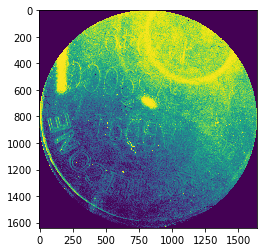

-189.9282395130375
189
<class 'numpy.ndarray'>


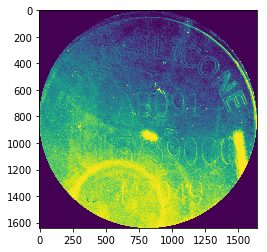

FULL-2019-04-26-150313.png.json
[1514. 1514.]
32.202484376209235 613.4248120185554
776 731
cos_alpha = -0.9507504183005943
sin_alpha = -0.3099574843446194


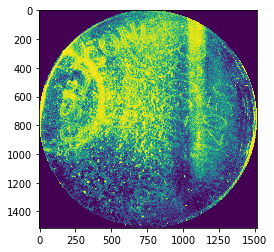

71.94333168045226
-71
<class 'numpy.ndarray'>


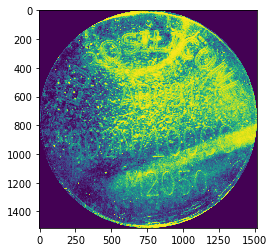

FULL-2019-04-26-155346.png.json
[1582. 1582.]
28.0178514522438 680.729020976776
819 792
cos_alpha = 0.7389114974379035
sin_alpha = -0.6738024925407111


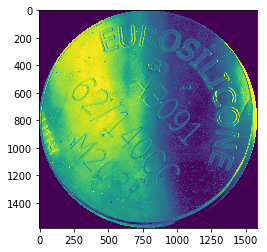

-47.63877422226229
47
<class 'numpy.ndarray'>


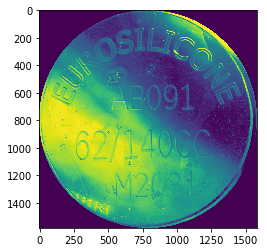

FULL-2019-04-26-161409.png.json
[1599. 1599.]
7.516648189186454 676.9833823662144
807 799
cos_alpha = -0.2869428593719815
sin_alpha = 0.9579476997495381


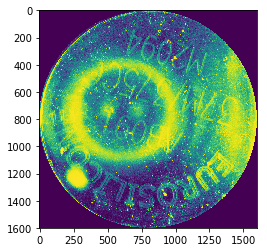

-196.67501769018875
196
<class 'numpy.ndarray'>


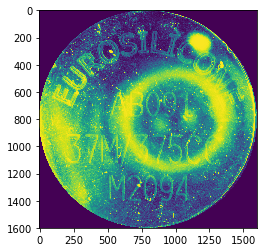

FULL-2019-04-26-134020.png.json
[1599. 1599.]
58.8430114796991 700.1703364182176
857 812
cos_alpha = 0.5777295960291159
sin_alpha = -0.8162282241334432


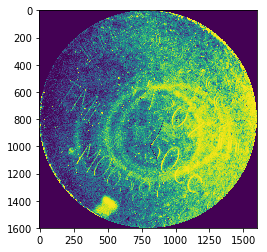

-35.29101245041325
35
<class 'numpy.ndarray'>


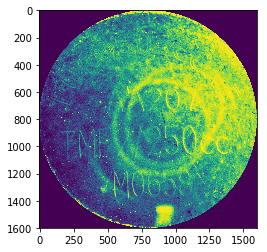

FULL-2019-04-26-140952.png.json
[1601. 1601.]
39.50316443020736 658.4500740375082
840 800
cos_alpha = 0.9472234953967361
sin_alpha = -0.320573938067943


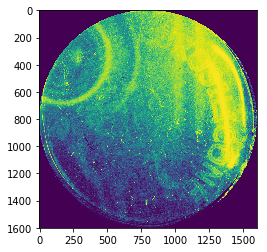

-71.30236223031585
71
<class 'numpy.ndarray'>


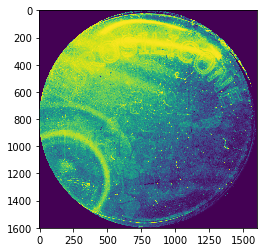

FULL-2019-04-26-122728.png.json
[1603. 1603.]
50.42320894191484 754.1302937821819
848 782
cos_alpha = 0.35809018567639256
sin_alpha = 0.9336870026525199


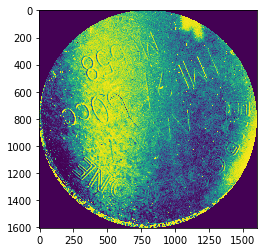

-159.01704597533683
159
<class 'numpy.ndarray'>


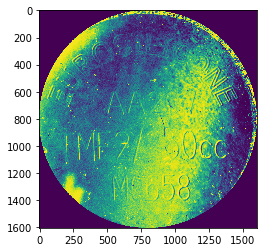

FULL-2019-04-26-161337.png.json
[1576. 1576.]
33.28663395418648 712.0737321373398
760 806
cos_alpha = -0.6944894726864884
sin_alpha = 0.7195028647112137


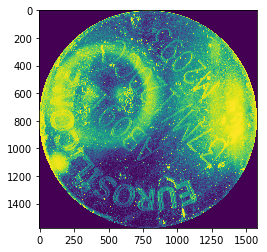

-223.98654873152637
223
<class 'numpy.ndarray'>


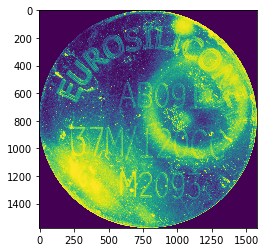

FULL-2019-04-26-122358.png.json
[1601. 1601.]
29.77414986191881 728.1349462839976
823 820
cos_alpha = 0.3175089036058046
sin_alpha = 0.9482552905895331


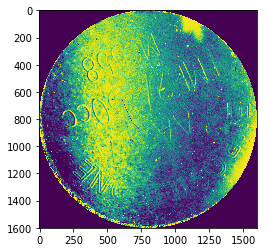

-161.48765935627526
161
<class 'numpy.ndarray'>


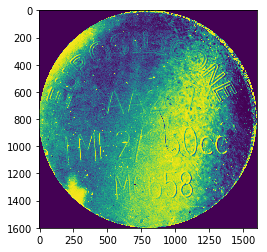

FULL-2019-04-26-144317.png.json
[1599. 1599.]
36.9120576505835 705.6787512742608
794 836
cos_alpha = 0.9059254066403848
sin_alpha = 0.42343731248374106


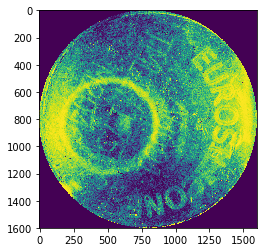

-115.0517904072741
115
<class 'numpy.ndarray'>


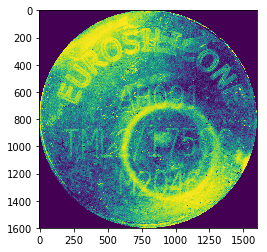

FULL-2019-04-26-161319.png.json
[1578. 1578.]
42.720018726587654 699.4576470380462
804 829
cos_alpha = 0.7395977898929327
sin_alpha = 0.6730491135017486


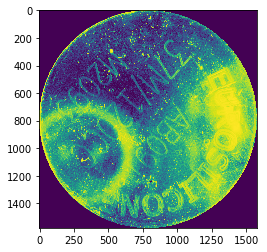

-132.30283529491805
132
<class 'numpy.ndarray'>


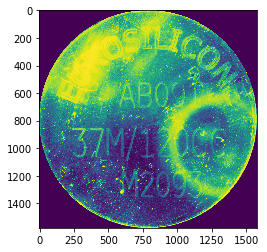

FULL-2019-04-26-153442.png.json
[1606. 1606.]
33.61547262794322 693.7759004174186
786 774
cos_alpha = 0.10906765550400176
sin_alpha = 0.9940343286440666


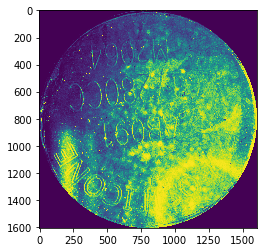

-173.73842720392764
173
<class 'numpy.ndarray'>


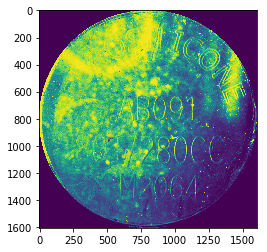

FULL-2019-04-26-143558.png.json
[1625. 1625.]
78.04165554369025 645.0864283179425
753 762
cos_alpha = 0.7288899008571816
sin_alpha = 0.6846309315451706


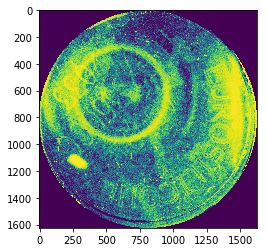

-133.20658891647034
133
<class 'numpy.ndarray'>


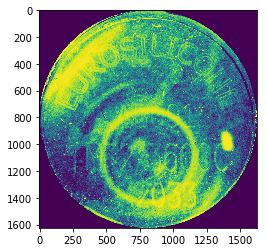

FULL-2019-04-26-151440.png.json
[1597. 1597.]
11.423659658795863 718.2746689115522
809 794
cos_alpha = -0.9704641628712549
sin_alpha = 0.24124532862336281


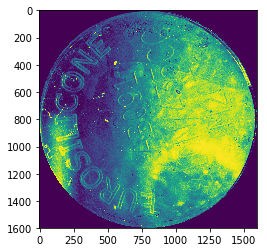

-256.0399476833241
256
<class 'numpy.ndarray'>


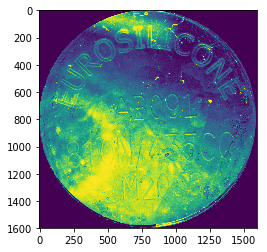

FULL-2019-04-26-161241.png.json
[1608. 1608.]
110.07270324653611 685.1313742633598
904 758
cos_alpha = -0.9769822911594501
sin_alpha = 0.21332042274670163


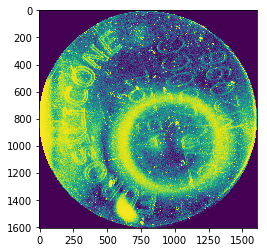

-257.6829911682374
257
<class 'numpy.ndarray'>


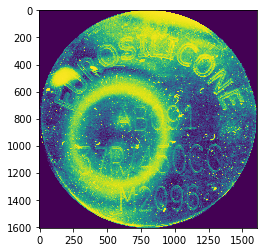

FULL-2019-04-26-144550.png.json
[1608. 1608.]
39.20459156782532 712.6941840649466
828 773
cos_alpha = -0.9782341251024411
sin_alpha = 0.20750420835506328


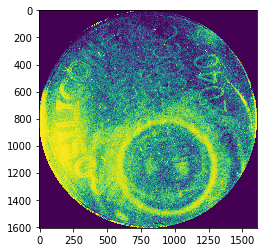

-258.02386755579664
258
<class 'numpy.ndarray'>


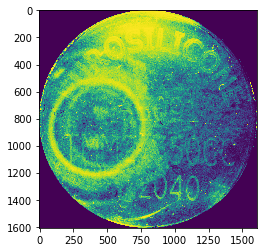

FULL-2019-04-26-144227.png.json
[1610. 1610.]
80.62257748298549 662.0045317065435
773 879
cos_alpha = 0.6090079099470033
sin_alpha = 0.793164147968113


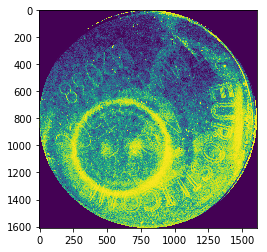

-142.4821970857745
142
<class 'numpy.ndarray'>


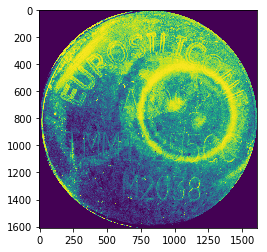

FULL-2019-04-26-153915.png.json
[1624. 1624.]
37.107950630558946 765.9144860883622
848 803
cos_alpha = 0.07832059286734347
sin_alpha = -0.9969282244639821


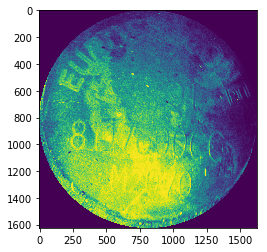

-4.492039875594335
4
<class 'numpy.ndarray'>


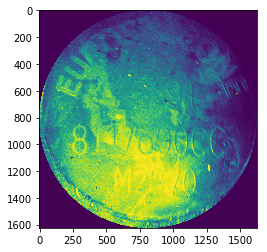

FULL-2019-04-26-145010.png.json
[1606. 1606.]
28.844410203711913 664.3929560132317
827 819
cos_alpha = 0.02797137815113968
sin_alpha = -0.9996087244538864


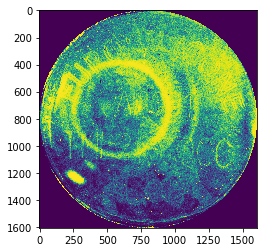

-1.6028509728082962
1
<class 'numpy.ndarray'>


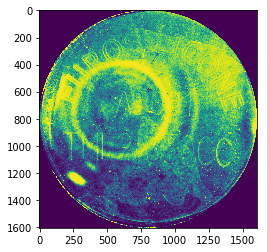

FULL-2019-04-26-151326.png.json
[1495. 1495.]
29.47032405658275 644.5436370021815
740 719
cos_alpha = -0.9994570299138176
sin_alpha = 0.03294913285430168


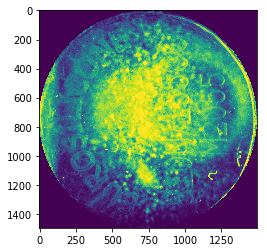

-268.11181199325915
268
<class 'numpy.ndarray'>


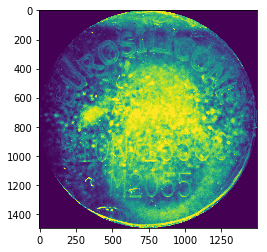

FULL-2019-04-26-152959.png.json
[1612. 1612.]
19.6468827043885 700.8744538075275
825 811
cos_alpha = 0.9982794243117468
sin_alpha = -0.05863608953372962


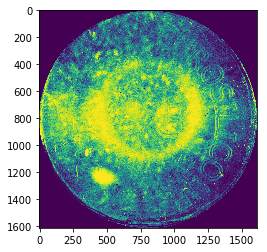

-86.63847139987158
86
<class 'numpy.ndarray'>


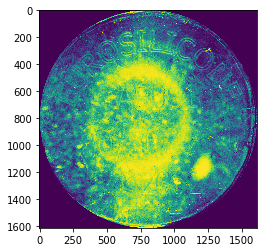

FULL-2019-04-26-121510.png.json
[1138. 1138.]
17.46424919657298 533.367603065653
573 552
cos_alpha = 0.8393639683758145
sin_alpha = -0.5435698010305617


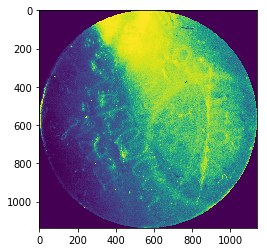

-57.07301707444581
57
<class 'numpy.ndarray'>


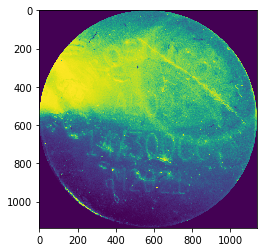

FULL-2019-04-26-153839.png.json
[1622. 1622.]
11.40175425099138 702.6378868236469
820 818
cos_alpha = -0.9166428943568485
sin_alpha = 0.39970714807856417


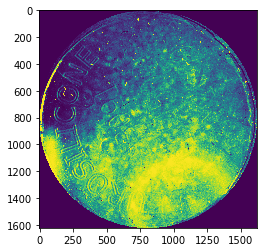

-246.44012783109895
246
<class 'numpy.ndarray'>


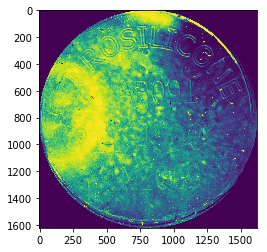

FULL-2019-04-26-141551.png.json
[1631. 1631.]
33.59315406448165 676.6243418618635
848 824
cos_alpha = -0.8467101878710472
sin_alpha = 0.5320543748108607


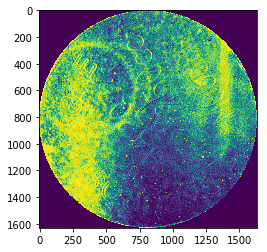

-237.85563397290912
237
<class 'numpy.ndarray'>


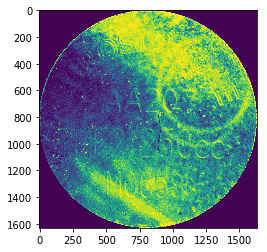

FULL-2019-04-26-151151.png.json
[1589. 1589.]
21.50581316760657 683.6757272274627
774 788
cos_alpha = -0.6397473102260598
sin_alpha = 0.7685853102021413


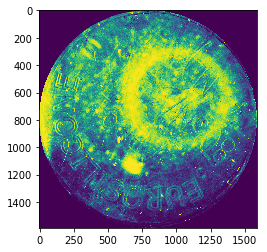

-219.7729796398571
219
<class 'numpy.ndarray'>


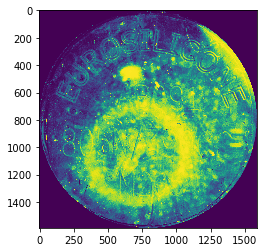

FULL-2019-04-26-154257.png.json
[1646. 1646.]
50.60632371551998 744.1511943147037
854 863
cos_alpha = 0.3495564701203797
sin_alpha = -0.9369152972371515


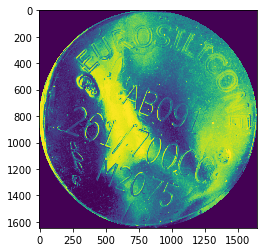

-20.46018925203509
20
<class 'numpy.ndarray'>


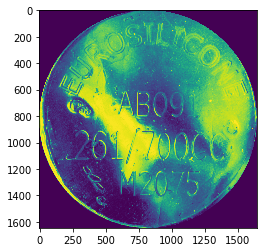

FULL-2019-04-26-153332.png.json
[1516. 1516.]
90.47098982546837 614.5185107057395
779 670
cos_alpha = -0.4110150582414485
sin_alpha = 0.9116285547846661


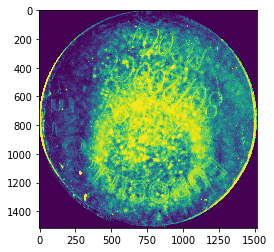

-204.26861513623768
204
<class 'numpy.ndarray'>


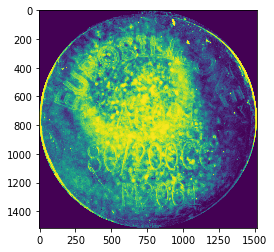

FULL-2019-04-26-160302.png.json
[1204. 1204.]
31.78049716414141 503.2236083492109
615 631
cos_alpha = -0.9996321362622941
sin_alpha = -0.02712180214665139


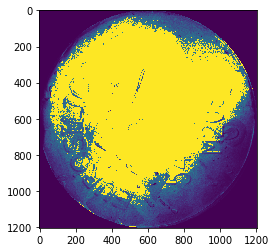

88.4458446270656
-88
<class 'numpy.ndarray'>


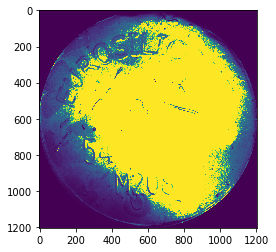

FULL-2019-04-26-154743.png.json
[1621. 1621.]
91.71968163922071 666.9231589920986
898 838
cos_alpha = -0.7571825848738979
sin_alpha = -0.6532032862468485


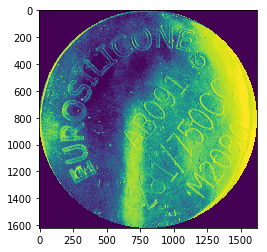

49.216446405075835
-49
<class 'numpy.ndarray'>


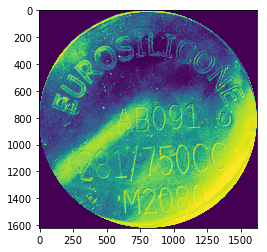

FULL-2019-04-26-153807.png.json
[1556. 1556.]
54.037024344425184 682.2975890328207
820 744
cos_alpha = 0.03873060808198209
sin_alpha = -0.9992496885151377


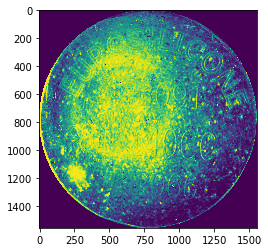

-2.219655553197882
2
<class 'numpy.ndarray'>


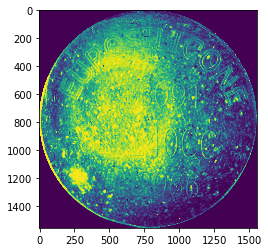

FULL-2019-04-26-141623.png.json
[1629. 1629.]
19.60867155112758 728.1830127104038
833 808
cos_alpha = 0.19295706462354306
sin_alpha = 0.9812072009580168


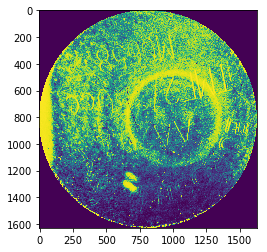

-168.87459435824127
168
<class 'numpy.ndarray'>


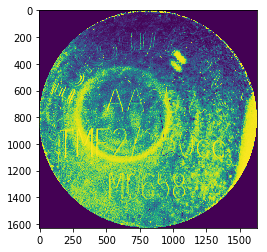

FULL-2019-04-26-144532.png.json
[1595. 1595.]
29.025850547399983 695.2427633568004
792 769
cos_alpha = 0.19053704751328376
sin_alpha = 0.9816800056662663


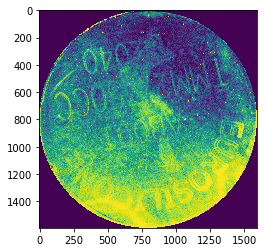

-169.0158726711736
169
<class 'numpy.ndarray'>


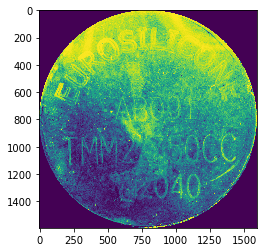

FULL-2019-04-26-144912.png.json
[1676. 1676.]
79.40403012442127 709.2820313528322
797 770
cos_alpha = 0.45278543965082696
sin_alpha = 0.8916195072115725


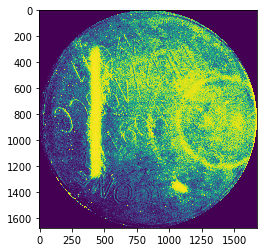

-153.07746419653898
153
<class 'numpy.ndarray'>


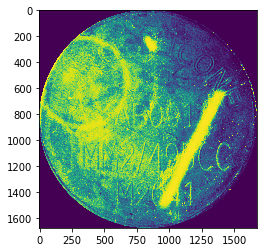

FULL-2019-04-26-153551.png.json
[1569. 1569.]
20.359273071502333 649.2229971281055
766 793
cos_alpha = 0.9020583851715284
sin_alpha = -0.43161402866650944


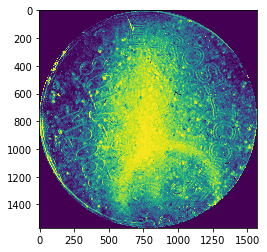

-64.429965861111
64
<class 'numpy.ndarray'>


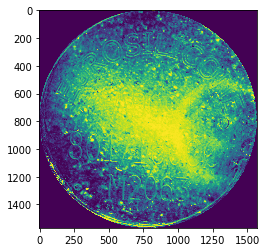

FULL-2019-04-26-140908.png.json
[1588. 1588.]
44.598206241955516 730.8029830262052
764 827
cos_alpha = 0.36896138995594435
sin_alpha = 0.9294447227897835


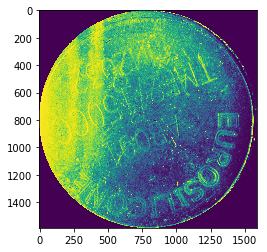

-158.34842223150088
158
<class 'numpy.ndarray'>


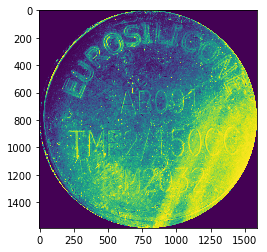

FULL-2019-04-26-153611.png.json
[1603. 1603.]
13.209844813622906 679.8253452174316
813 808
cos_alpha = -0.9732844374741829
sin_alpha = -0.2296027085436129


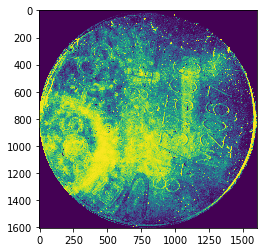

76.72631732544416
-76
<class 'numpy.ndarray'>


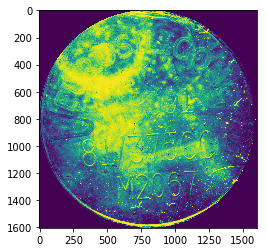

FULL-2019-04-26-122433.png.json
[1593. 1593.]
40.749233121618374 738.4107935289137
837 801
cos_alpha = 0.36177469415651864
sin_alpha = 0.932265558018721


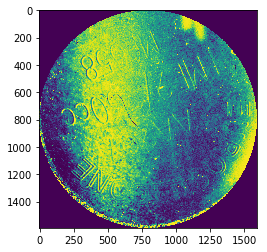

-158.7907738657772
158
<class 'numpy.ndarray'>


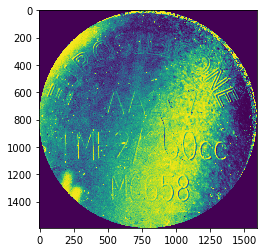

FULL-2019-04-26-145917.png.json
[1602. 1602.]
72.61542535852834 723.7851891272713
773 868
cos_alpha = 0.9091258674067679
sin_alpha = -0.4165214966984199


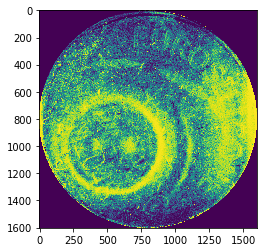

-65.3848310198887
65
<class 'numpy.ndarray'>


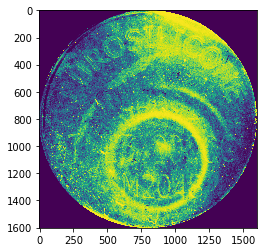

FULL-2019-04-26-145657.png.json
[1612. 1612.]
95.524865872714 696.3799250409219
757 888
cos_alpha = 0.6130651234330858
sin_alpha = -0.7900323755581002


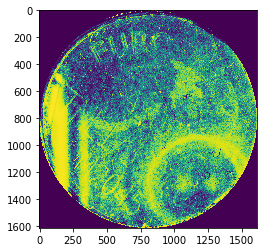

-37.81146285726335
37
<class 'numpy.ndarray'>


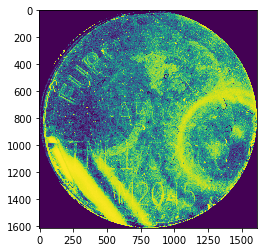

FULL-2019-04-26-154720.png.json
[1599. 1599.]
33.324165405903265 668.6677052168737
829 815
cos_alpha = 0.0146397193787106
sin_alpha = -0.9998928335659341


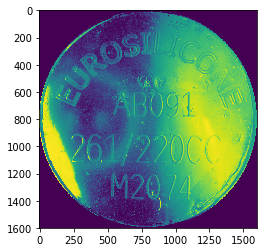

-0.8388240984658941
0
<class 'numpy.ndarray'>


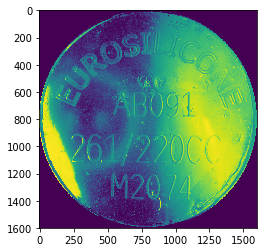

FULL-2019-04-26-144442.png.json
[1663. 1663.]
53.949050037975645 704.7357660854173
876 862
cos_alpha = 0.893539280422646
sin_alpha = -0.448985026856999


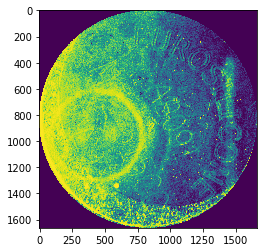

-63.32141704381
63
<class 'numpy.ndarray'>


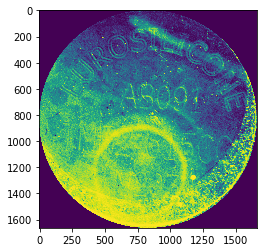

FULL-2019-04-26-144746.png.json
[1608. 1608.]
74.96665925596525 691.0542670442026
792 878
cos_alpha = 0.46992889387890835
sin_alpha = 0.8827042736374089


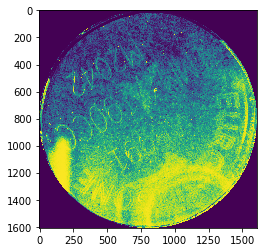

-151.97031901771663
151
<class 'numpy.ndarray'>


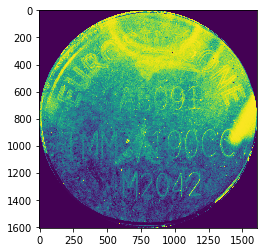

FULL-2019-04-26-140853.png.json
[1593. 1593.]
22.638462845343543 733.2260906432613
819 799
cos_alpha = 0.35006179087557115
sin_alpha = 0.9367266103666468


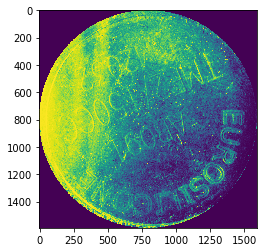

-159.50890543382422
159
<class 'numpy.ndarray'>


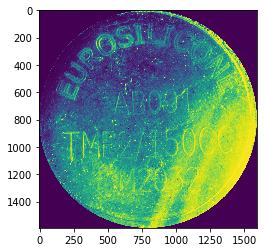

FULL-2019-04-26-144335.png.json
[1595. 1595.]
49.502525188115406 696.5791412323513
752 817
cos_alpha = -0.39245577709843305
sin_alpha = 0.9197708752847445


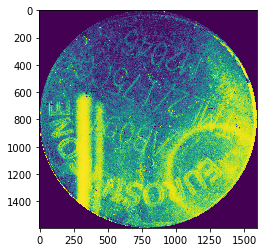

-203.10739157831148
203
<class 'numpy.ndarray'>


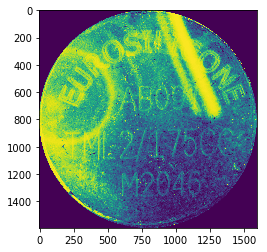

FULL-2019-04-26-161514.png.json
[1597. 1597.]
48.974483151943524 714.3630029613796
821 755
cos_alpha = -0.9345088518304853
sin_alpha = 0.35593989078279537


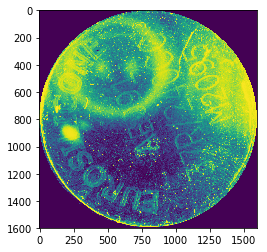

-249.1489408913967
249
<class 'numpy.ndarray'>


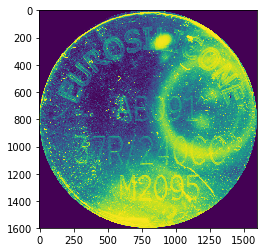

FULL-2019-04-26-142147.png.json
[1594. 1594.]
30.675723300355934 683.3717875358917
787 768
cos_alpha = 0.9627817203287885
sin_alpha = -0.2702801491059573


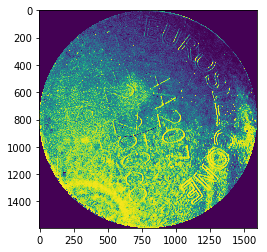

-74.31906196993567
74
<class 'numpy.ndarray'>


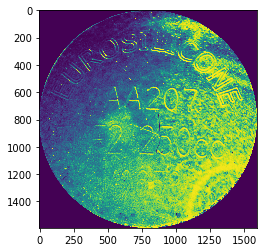

FULL-2019-04-26-155041.png.json
[1616. 1616.]
47.80167361086848 682.5393761534934
795 854
cos_alpha = 0.8952662364521855
sin_alpha = -0.44553155429075897


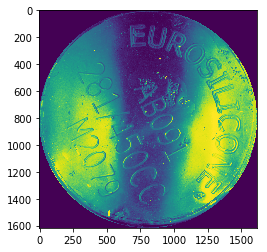

-63.54264752975049
63
<class 'numpy.ndarray'>


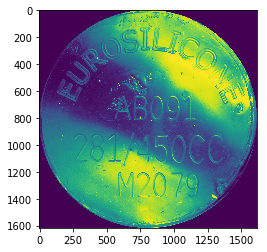

FULL-2019-04-26-154414.png.json
[1597. 1597.]
76.63223864666881 685.0025547397615
875 794
cos_alpha = -0.9974786736944068
sin_alpha = -0.07096686216007637


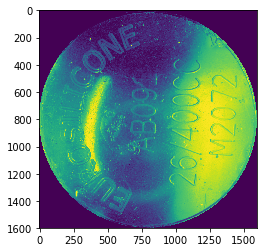

85.93047753968983
-85
<class 'numpy.ndarray'>


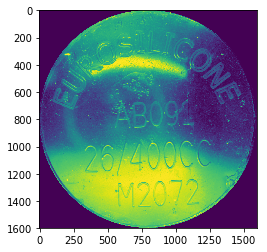

FULL-2019-04-26-153500.png.json
[1619. 1619.]
92.46891369536034 695.1075456359254
764 890
cos_alpha = 0.9619708260855806
sin_alpha = -0.2731522098761525


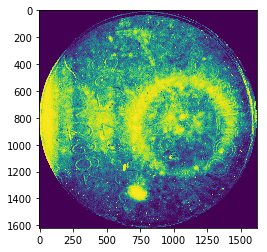

-74.14807184571305
74
<class 'numpy.ndarray'>


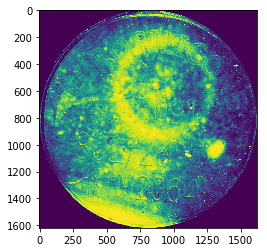

FULL-2019-04-26-154813.png.json
[1636. 1636.]
122.64175471673585 699.0064377385947
883 714
cos_alpha = -0.7686236960300886
sin_alpha = 0.6397011911049141


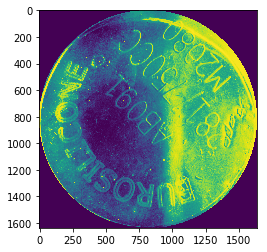

-230.23045831943793
230
<class 'numpy.ndarray'>


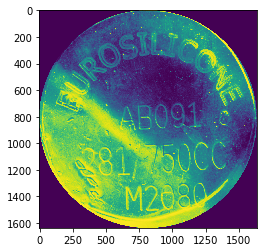

FULL-2019-04-26-144705.png.json
[1704. 1704.]
84.21995013059554 704.5970479642957
810 925
cos_alpha = 0.9982651321778384
sin_alpha = -0.05887890860030146


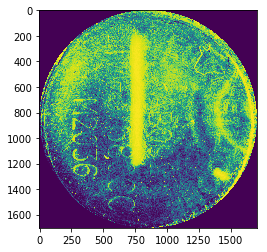

-86.62453481369705
86
<class 'numpy.ndarray'>


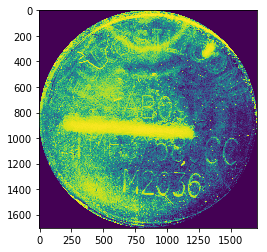

FULL-2019-04-26-140825.png.json
[1616. 1616.]
47.634021455258214 723.2164268045908
838 845
cos_alpha = 0.9150861860659874
sin_alpha = -0.40325831928331646


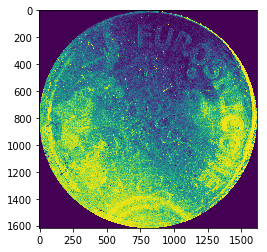

-66.21796957677863
66
<class 'numpy.ndarray'>


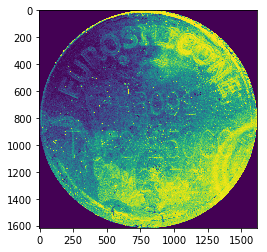

FULL-2019-04-26-140937.png.json
[1618. 1618.]
61.741396161732524 709.8859063257983
835 865
cos_alpha = 0.9062553654924528
sin_alpha = -0.42273066190677594


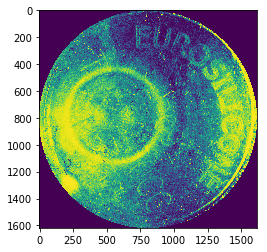

-64.99289397986989
64
<class 'numpy.ndarray'>


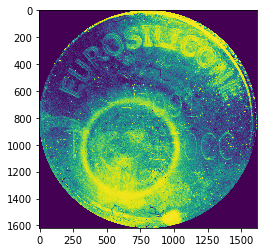

FULL-2019-04-26-150258.png.json
[1497. 1497.]
19.300259065618782 628.8580921002766
733 737
cos_alpha = -0.19943694555322455
sin_alpha = 0.9799106616158434


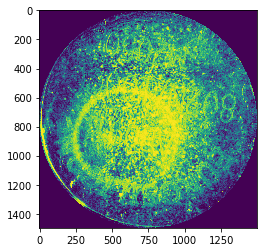

-191.50403508059938
191
<class 'numpy.ndarray'>


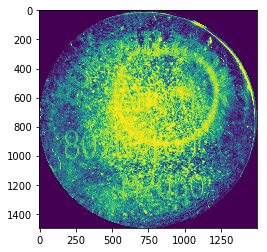

FULL-2019-04-26-153744.png.json
[1559. 1559.]
61.15962720618889 686.0397218820497
745 729
cos_alpha = -0.9976813062693644
sin_alpha = -0.06805887980752252


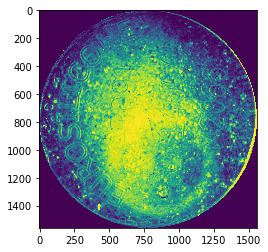

86.09749672550919
-86
<class 'numpy.ndarray'>


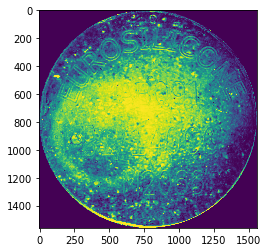

FULL-2019-04-26-143643.png.json
[1620. 1620.]
27.784887978899608 663.8870385841254
834 824
cos_alpha = -0.5695224988599562
sin_alpha = 0.8219757437371927


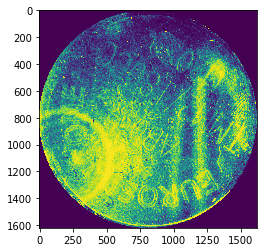

-214.71693485674356
214
<class 'numpy.ndarray'>


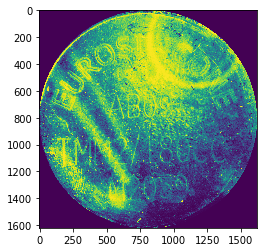

FULL-2019-04-26-154428.png.json
[1599. 1599.]
90.99725270578227 664.8266691401602
809 890
cos_alpha = 0.10882905119938106
sin_alpha = -0.9940604798577611


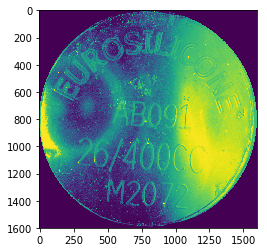

-6.247819911145224
6
<class 'numpy.ndarray'>


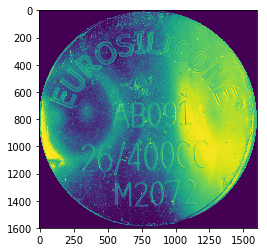

FULL-2019-04-26-145938.png.json
[1582. 1582.]
41.86884283091664 693.8775108043205
759 764
cos_alpha = 0.35741856872301697
sin_alpha = 0.9339443060118681


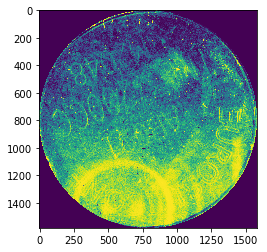

-159.05825412497595
159
<class 'numpy.ndarray'>


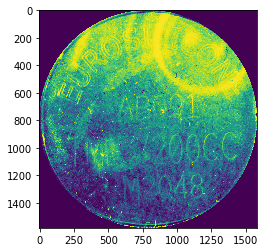

FULL-2019-04-26-151313.png.json
[1490. 1490.]
14.866068747318506 632.0640790299667
755 756
cos_alpha = -0.0016103038703057682
sin_alpha = 0.9999987034598821


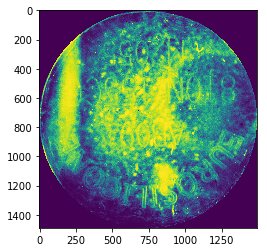

-180.0922636553766
180
<class 'numpy.ndarray'>


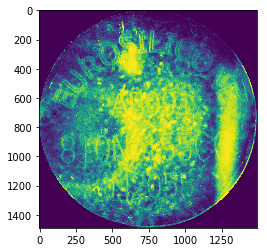

FULL-2019-04-26-154943.png.json
[1526. 1526.]
57.87054518492115 628.6851358191952
820 773
cos_alpha = -0.6966549413348714
sin_alpha = -0.7174063651193143


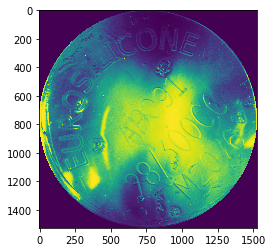

44.15924178369122
-44
<class 'numpy.ndarray'>


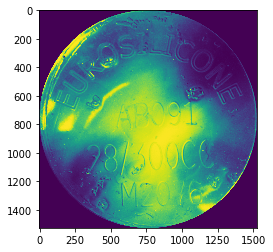

FULL-2019-04-26-161849.png.json
[1384. 1384.]
113.46365056704283 612.4124427214065
627 599
cos_alpha = -0.8002382212456185
sin_alpha = -0.5996822402386521


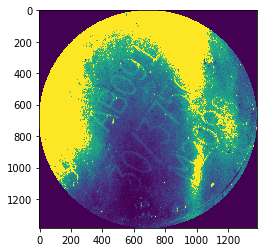

53.15285683251214
-53
<class 'numpy.ndarray'>


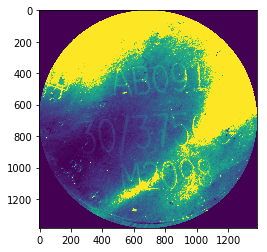

FULL-2019-04-26-155958.png.json
[657. 657.]
14.230249470757707 271.8427854477657
315 333
cos_alpha = 0.2009441437213313
sin_alpha = -0.9796027006414901


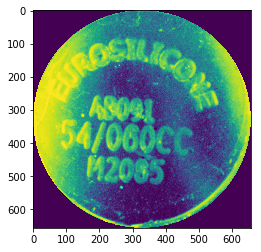

-11.592175410291063
11
<class 'numpy.ndarray'>


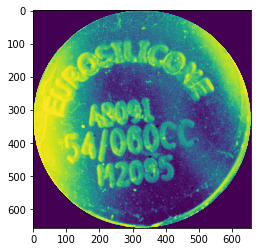

FULL-2019-04-26-152239.png.json
[1612. 1612.]
42.941821107167776 650.1269106874441
844 826
cos_alpha = -0.19810588796058864
sin_alpha = -0.9801806247602258


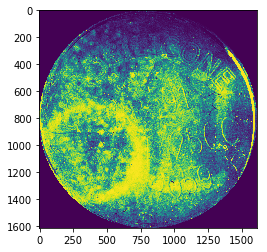

11.426218326702298
-11
<class 'numpy.ndarray'>


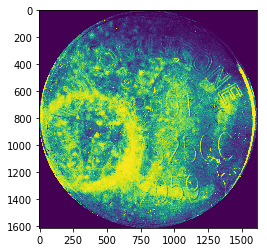

FULL-2019-04-26-145454.png.json
[1665. 1665.]
32.44225639501667 636.1041581376434
817 861
cos_alpha = 0.9913343009766119
sin_alpha = -0.13136325097687


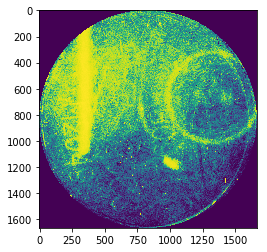

-82.45162352718681
82
<class 'numpy.ndarray'>


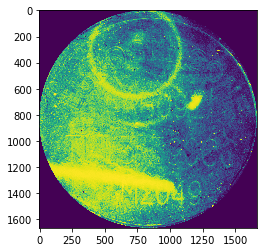

FULL-2019-04-26-160837.png.json
[1589. 1589.]
43.982951242498494 649.6248917644705
828 766
cos_alpha = -0.9799607204713748
sin_alpha = 0.19919082893854356


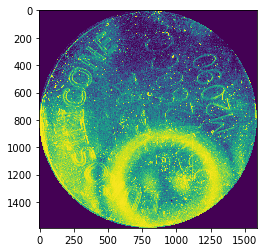

-258.51035509147425
258
<class 'numpy.ndarray'>


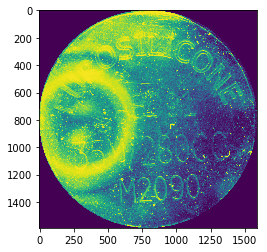

FULL-2019-04-26-155431.png.json
[1621. 1621.]
62.27760432129676 684.3175432502078
844 758
cos_alpha = -0.777839968245161
sin_alpha = 0.6284623964887374


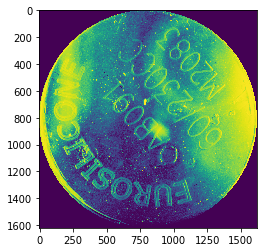

-231.0632281762405
231
<class 'numpy.ndarray'>


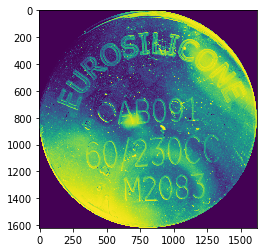

FULL-2019-04-26-121709.png.json
[1661. 1661.]
48.708315511830214 692.7369630675124
877 845
cos_alpha = 0.9953691742669663
sin_alpha = 0.09612599502266653


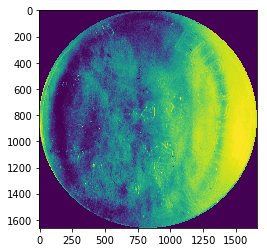

-95.51613119531294
95
<class 'numpy.ndarray'>


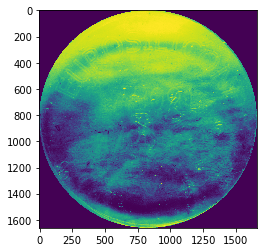

FULL-2019-04-26-154607.png.json
[1535. 1535.]
77.86205751198719 663.3615153142365
782 691
cos_alpha = -0.5891497735032222
sin_alpha = -0.8080238513689444


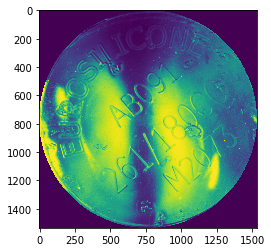

36.09669673846656
-36
<class 'numpy.ndarray'>


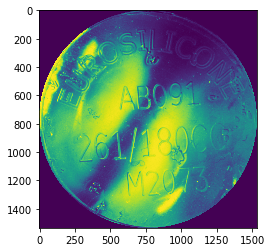

FULL-2019-04-26-161500.png.json
[1584. 1584.]
70.3846574190711 722.2769551910126
727 765
cos_alpha = 0.31701040010776593
sin_alpha = 0.9484220612277607


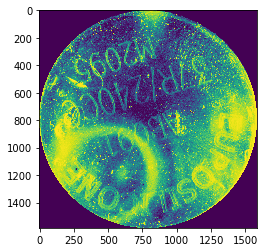

-161.51777744233254
161
<class 'numpy.ndarray'>


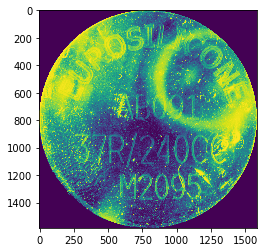

FULL-2019-04-26-153019.png.json
[1623. 1623.]
4.743416490252569 710.4340222708933
813 807
cos_alpha = 0.08813878771455368
sin_alpha = 0.9961082040120987


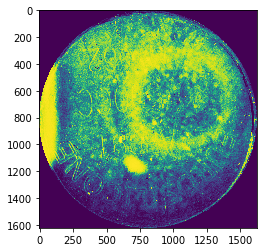

-174.9434580725208
174
<class 'numpy.ndarray'>


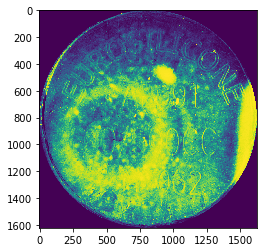

FULL-2019-04-26-152151.png.json
[1563. 1563.]
5.1478150704935 665.8472046948909
779 786
cos_alpha = 0.03628471381383216
sin_alpha = 0.9993414929559606


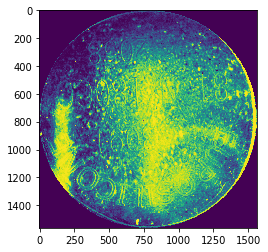

-177.92058258058037
177
<class 'numpy.ndarray'>


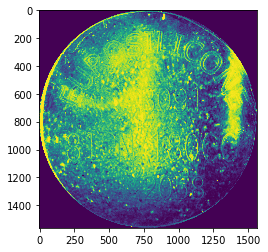

FULL-2019-04-26-154701.png.json
[1597. 1597.]
28.257742301889582 670.9474644113353
826 805
cos_alpha = -0.004431271116114992
sin_alpha = -0.9999901818699498


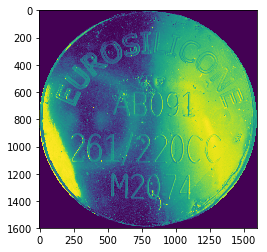

0.25389396375348305
0
<class 'numpy.ndarray'>


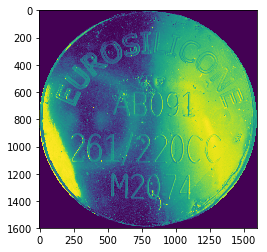

FULL-2019-04-26-153518.png.json
[1557. 1557.]
40.798284277650694 642.9825036499827
817 792
cos_alpha = -0.4189636256343278
sin_alpha = -0.9080030178338279


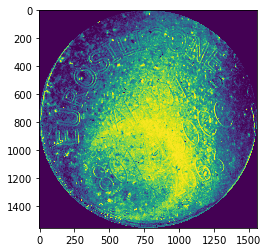

24.769174123001875
-24
<class 'numpy.ndarray'>


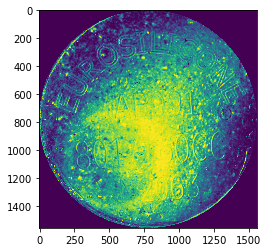

FULL-2019-04-26-134950.png.json
[1514. 1514.]
5.0 677.9387877972465
753 754
cos_alpha = 0.9229029126566001
sin_alpha = -0.38503274381533314


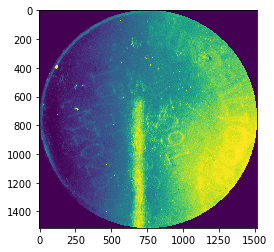

-67.35422694632628
67
<class 'numpy.ndarray'>


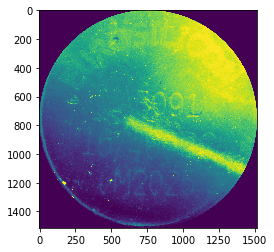

FULL-2019-04-26-143352.png.json
[1651. 1651.]
18.12456896039186 705.5469509536555
833 842
cos_alpha = 0.08424752442011205
sin_alpha = 0.9964448577964977


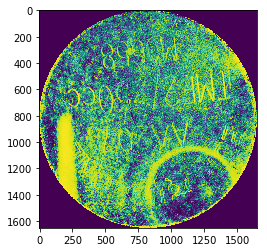

-175.16724401286504
175
<class 'numpy.ndarray'>


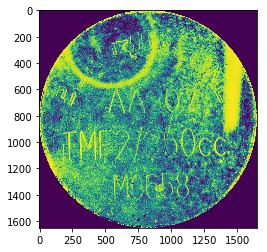

FULL-2019-04-26-155521.png.json
[1580. 1580.]
39.0 694.2002592912221
805 754
cos_alpha = -0.7828747154914729
sin_alpha = 0.6221793791537495


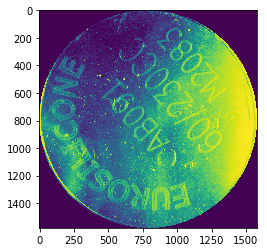

-231.52454046469828
231
<class 'numpy.ndarray'>


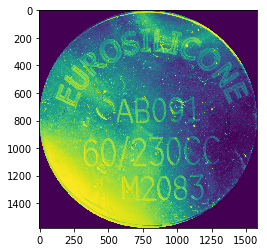

FULL-2019-04-26-142133.png.json
[1593. 1593.]
32.53459696999488 689.8887591488935
798 764
cos_alpha = 0.9682083803737843
sin_alpha = -0.2501450222850203


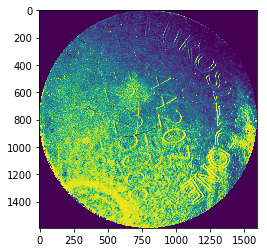

-75.51390597952026
75
<class 'numpy.ndarray'>


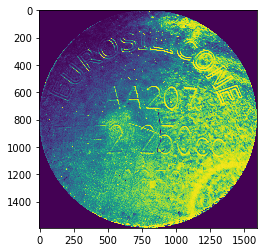

FULL-2019-04-26-161532.png.json
[1610. 1610.]
58.309518948453004 695.1848674992862
835 755
cos_alpha = -0.9462185213293408
sin_alpha = 0.3235282211698318


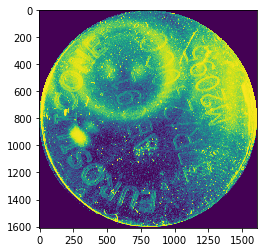

-251.1235684628045
251
<class 'numpy.ndarray'>


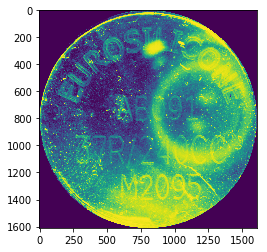

FULL-2019-04-26-143723.png.json
[1627. 1627.]
25.894014752448104 633.5112469404154
809 839
cos_alpha = 0.884349417917102
sin_alpha = -0.46682556381338314


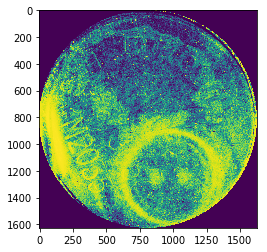

-62.17156647639519
62
<class 'numpy.ndarray'>


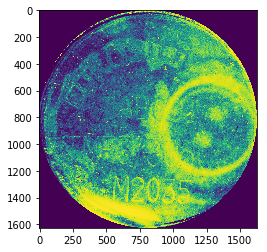

FULL-2019-04-26-153902.png.json
[1661. 1661.]
52.15841255253078 675.4839006223613
856 876
cos_alpha = -0.32200141018531747
sin_alpha = -0.9467391889209334


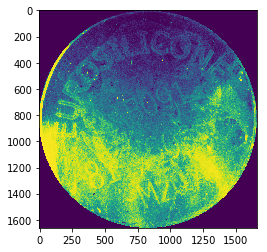

18.784004954094467
-18
<class 'numpy.ndarray'>


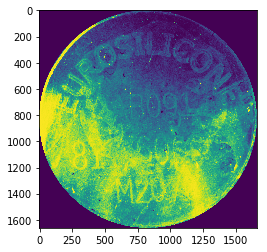

FULL-2019-04-26-155116.png.json
[1554. 1554.]
32.01562118716424 664.2537165872691
808 769
cos_alpha = 0.14743917388997468
sin_alpha = -0.9890711248452468


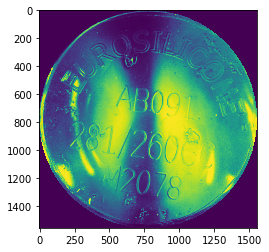

-8.478551973569953
8
<class 'numpy.ndarray'>


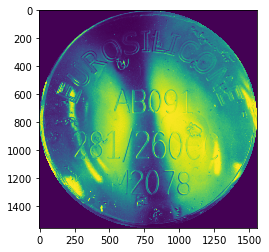

FULL-2019-04-26-160057.png.json
[824. 824.]
62.12889826803627 320.0140621910231
408 474
cos_alpha = 0.018321531483200985
sin_alpha = -0.9998321466546822


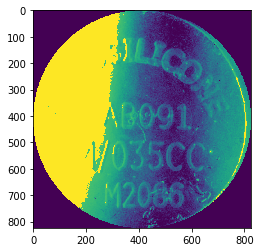

-1.04980516663051
1
<class 'numpy.ndarray'>


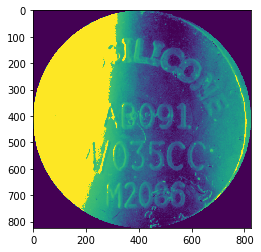

FULL-2019-04-26-154759.png.json
[1638. 1638.]
115.10864433221339 673.2109624775877
884 724
cos_alpha = -0.6578749827141488
sin_alpha = 0.753127152026043


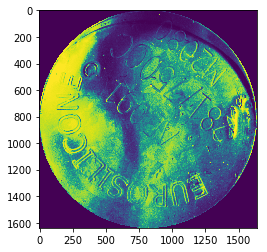

-221.13800755960634
221
<class 'numpy.ndarray'>


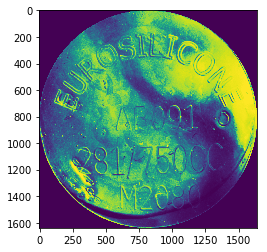

FULL-2019-04-26-145352.png.json
[1603. 1603.]
66.45675285477014 590.9437367465705
741 829
cos_alpha = 0.9828030117942264
sin_alpha = -0.18465708761972266


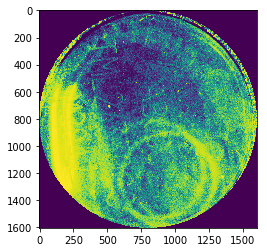

-79.35885947894847
79
<class 'numpy.ndarray'>


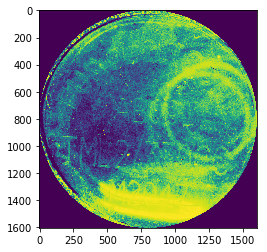

FULL-2019-04-26-135349.png.json
[993. 993.]
17.7341478509682 339.0612039145735
480 503
cos_alpha = 0.9993301717219037
sin_alpha = 0.036595189386999294


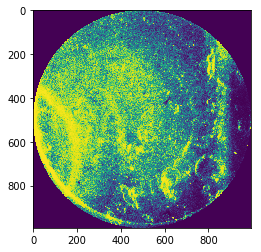

-92.09721818195175
92
<class 'numpy.ndarray'>


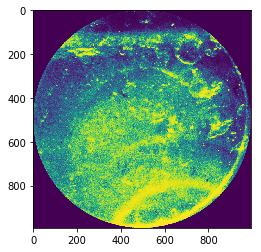

FULL-2019-04-26-152206.png.json
[1569. 1569.]
11.76860229593982 643.5048562365322
782 796
cos_alpha = -0.9999014458859478
sin_alpha = -0.0140391778673534


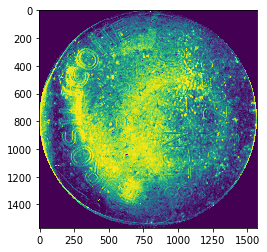

89.19558793415426
-89
<class 'numpy.ndarray'>


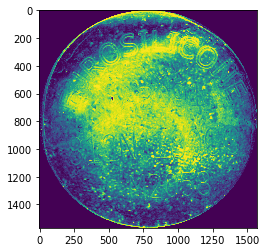

FULL-2019-04-26-135503.png.json
[1274. 1274.]
60.92618484691127 447.15321758878133
613 693
cos_alpha = -0.12230713191444709
sin_alpha = -0.9924922999614969


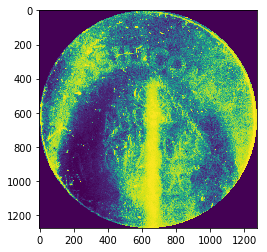

7.02527249129634
-7
<class 'numpy.ndarray'>


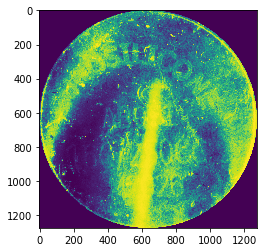

FULL-2019-04-26-161730.png.json
[1631. 1631.]
53.89341332667657 707.6443315677728
869 809
cos_alpha = -0.3250018015712343
sin_alpha = -0.9457133968467677


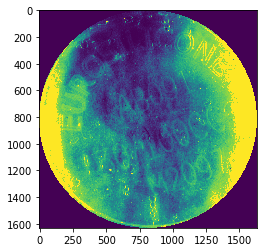

18.965684136498147
-18
<class 'numpy.ndarray'>


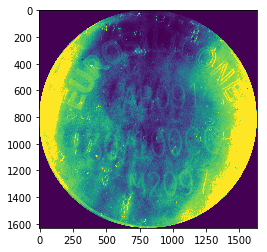

FULL-2019-04-26-150014.png.json
[1589. 1589.]
39.528470752104745 717.2910845674858
757 782
cos_alpha = 0.3864311523237293
sin_alpha = 0.9223182555461832


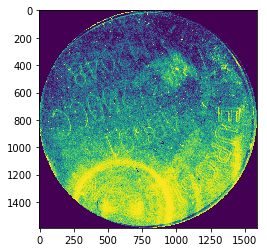

-157.26738327510938
157
<class 'numpy.ndarray'>


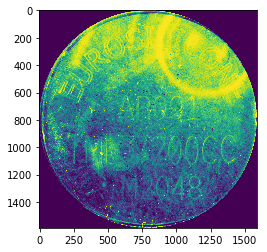

FULL-2019-04-26-160919.png.json
[1599. 1599.]
19.60867155112758 736.9793077149453
781 806
cos_alpha = -0.8402358186488789
sin_alpha = -0.5422211440542026


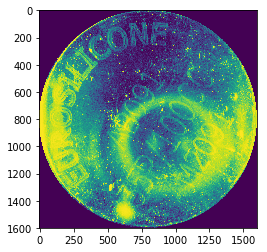

57.16502987028695
-57
<class 'numpy.ndarray'>


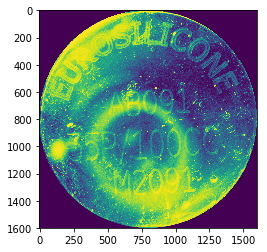

FULL-2019-04-26-154317.png.json
[1567. 1567.]
48.25453346577915 668.9293684687494
831 775
cos_alpha = -0.6844202776734802
sin_alpha = -0.7290877063216442


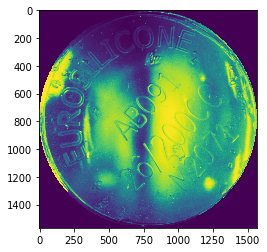

43.190032314170644
-43
<class 'numpy.ndarray'>


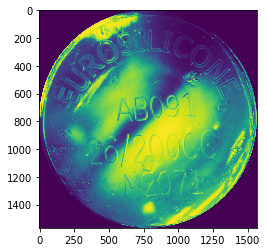

FULL-2019-04-26-134332.png.json
[1633. 1633.]
40.05621050473946 665.3889839785447
853 833
cos_alpha = -0.20139461803376407
sin_alpha = 0.9795101877096707


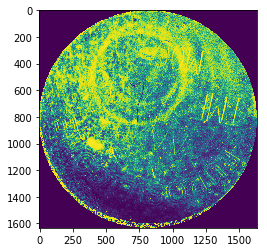

-191.61852435279462
191
<class 'numpy.ndarray'>


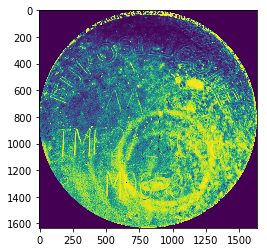

FULL-2019-04-26-155805.png.json
[1608. 1608.]
59.682493245507096 710.8938036021976
855 773
cos_alpha = -0.9142394560805753
sin_alpha = 0.4051743043993459


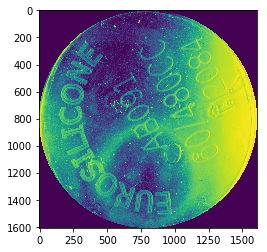

-246.09794958898914
246
<class 'numpy.ndarray'>


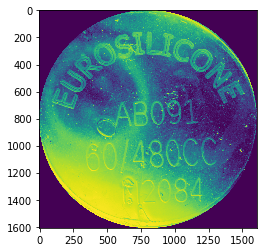

FULL-2019-04-26-145730.png.json
[1600. 1600.]
96.77293009927931 709.8225130270242
706 777
cos_alpha = 0.8909160190439798
sin_alpha = 0.45416808233387235


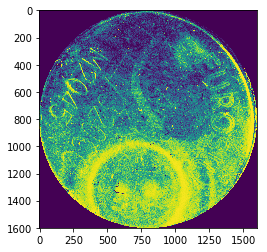

-117.01141994995776
117
<class 'numpy.ndarray'>


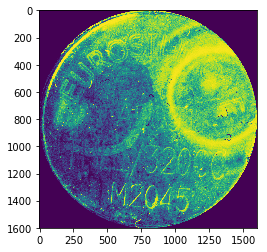

FULL-2019-04-26-155720.png.json
[1577. 1577.]
15.700318468107582 658.2176691642363
779 776
cos_alpha = 0.6306484871331535
sin_alpha = 0.7760686088720924


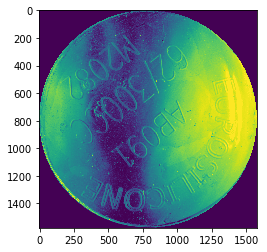

-140.90201703837903
140
<class 'numpy.ndarray'>


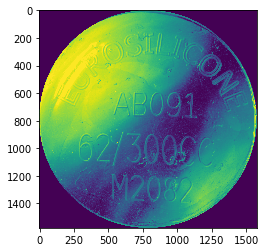

FULL-2019-04-26-144724.png.json
[1697. 1697.]
31.81980515339464 759.1538052331688
826 826
cos_alpha = 0.06897744412517068
sin_alpha = 0.9976182196621907


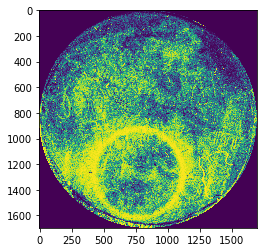

-176.04474288658875
176
<class 'numpy.ndarray'>


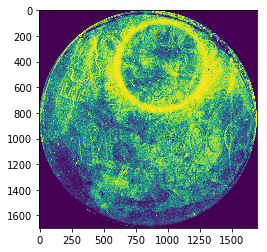

FULL-2019-04-26-145711.png.json
[1608. 1608.]
98.00510190801293 698.8912647901675
757 890
cos_alpha = 0.6121985469495612
sin_alpha = -0.7907040780929652


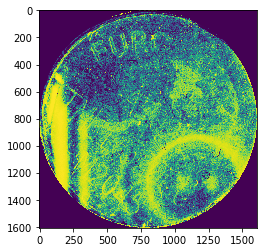

-37.748642555950504
37
<class 'numpy.ndarray'>


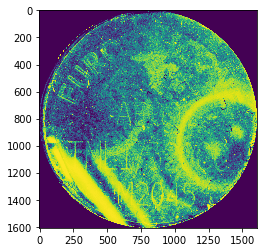

FULL-2019-04-26-155056.png.json
[1614. 1614.]
37.21558813185679 707.9244309952863
803 844
cos_alpha = 0.9056902265584384
sin_alpha = -0.42394010604863075


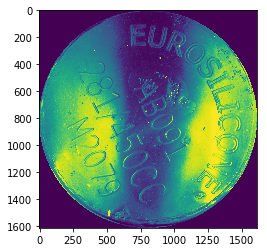

-64.91640599380908
64
<class 'numpy.ndarray'>


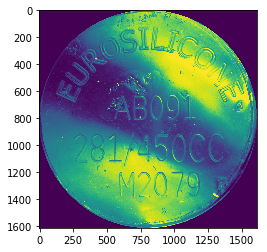

FULL-2019-04-26-151422.png.json
[1584. 1584.]
25.495097567963924 701.9088259881051
775 773
cos_alpha = 0.2635844597813549
sin_alpha = 0.9646363213987805


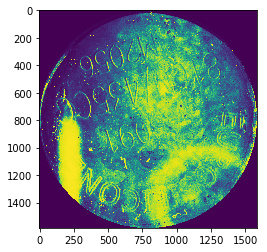

-164.71714187547698
164
<class 'numpy.ndarray'>


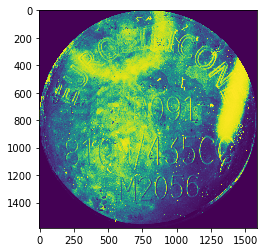

FULL-2019-04-26-151035.png.json
[1555. 1555.]
85.10287891722582 645.2693236161161
846 727
cos_alpha = -0.8758973710502337
sin_alpha = 0.48249745635318037


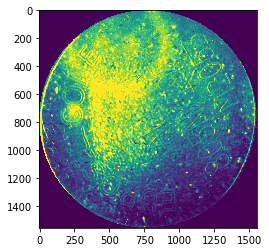

-241.15135774135499
241
<class 'numpy.ndarray'>


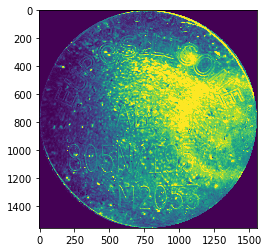

FULL-2019-04-26-160236.png.json
[1191. 1191.]
57.554322166106694 497.2650198837638
593 653
cos_alpha = 0.14066389387663972
sin_alpha = -0.9900574069009641


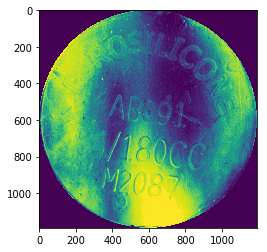

-8.086264734926537
8
<class 'numpy.ndarray'>


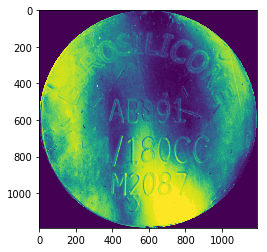

FULL-2019-04-26-155943.png.json
[671. 671.]
22.4610774452162 269.60804884127623
342 357
cos_alpha = 0.19012939172491575
sin_alpha = -0.9817590409068376


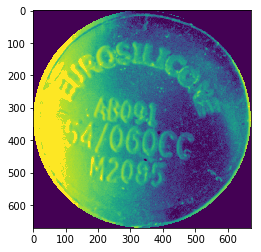

-10.960335446035092
10
<class 'numpy.ndarray'>


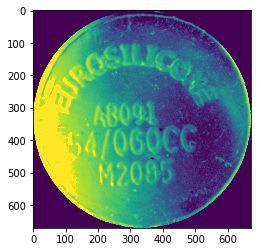

FULL-2019-04-26-154643.png.json
[1593. 1593.]
18.398369492974098 673.8430826238406
809 783
cos_alpha = -0.9999320080569667
sin_alpha = -0.011661014671218271


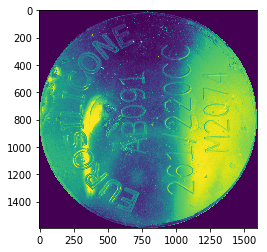

89.33185793167144
-89
<class 'numpy.ndarray'>


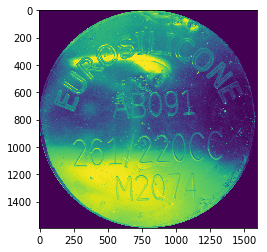

FULL-2019-04-26-121732.png.json
[640. 640.]
31.400636936215164 283.24018076537095
345 301
cos_alpha = 0.8493334163370689
sin_alpha = -0.5278567494057484


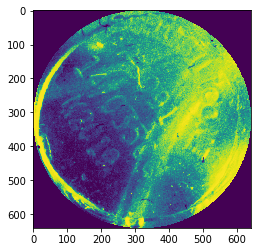

-58.13924192736331
58
<class 'numpy.ndarray'>


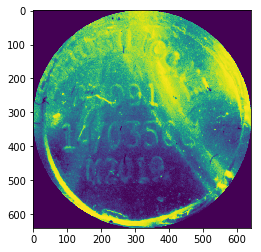

FULL-2019-04-26-135732.png.json
[1335. 1335.]
9.513148795220223 595.0936901026594
658 668
cos_alpha = 0.9957012159921018
sin_alpha = -0.09262336892949784


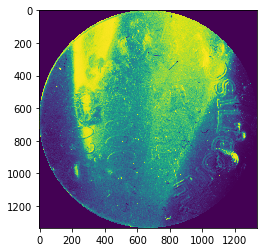

-84.68545433005526
84
<class 'numpy.ndarray'>


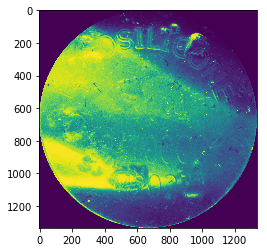

FULL-2019-04-26-141007.png.json
[1608. 1608.]
40.0 667.7012805139735
836 828
cos_alpha = 0.3599309616928668
sin_alpha = 0.9329789401775628


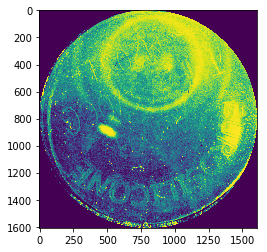

-158.90404379303396
158
<class 'numpy.ndarray'>


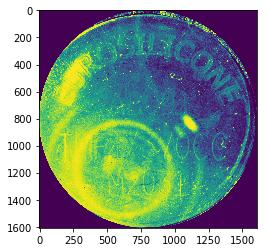

FULL-2019-04-26-151022.png.json
[1563. 1563.]
83.5134719671024 642.1405609366224
838 843
cos_alpha = -0.3040671070128671
sin_alpha = -0.9526506150907716


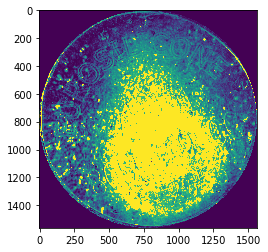

17.70204764050904
-17
<class 'numpy.ndarray'>


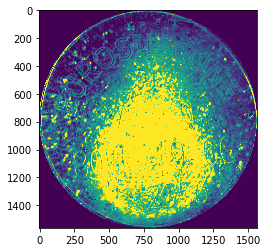

FULL-2019-04-26-143701.png.json
[1612. 1612.]
25.298221281347036 677.9867255337674
798 830
cos_alpha = -0.752125920149294
sin_alpha = -0.6590194232642751


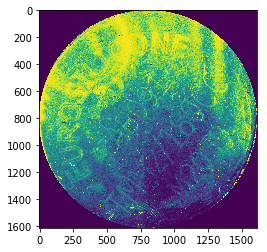

48.77486875069211
-48
<class 'numpy.ndarray'>


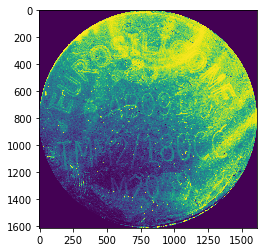

FULL-2019-04-26-144105.png.json
[1603. 1603.]
71.33372274037013 719.8003195331328
865 834
cos_alpha = 0.5853870470971506
sin_alpha = -0.8107539732192982


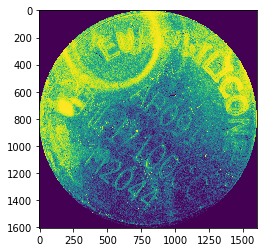

-35.830337821280935
35
<class 'numpy.ndarray'>


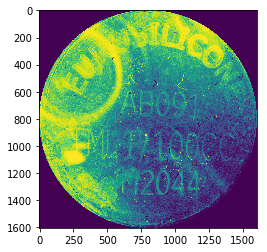

FULL-2019-04-26-140123.png.json
[1541. 1541.]
73.27004845091888 597.1335696475287
799 838
cos_alpha = -0.08403900314829149
sin_alpha = -0.9964624659011705


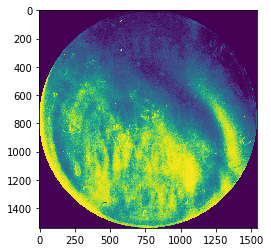

4.820766078092662
-4
<class 'numpy.ndarray'>


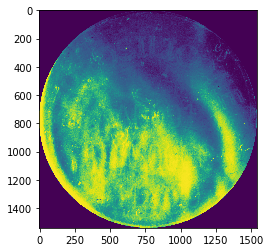

FULL-2019-04-26-160041.png.json
[880. 880.]
54.817880294662984 358.91224554199874
406 483
cos_alpha = 0.97970375042776
sin_alpha = -0.2004508952281862


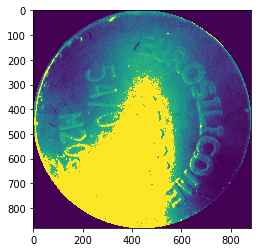

-78.43667261018675
78
<class 'numpy.ndarray'>


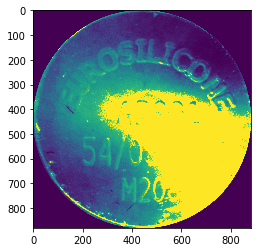

FULL-2019-04-26-144514.png.json
[1636. 1636.]
61.29437168288782 706.0708179779136
852 869
cos_alpha = 0.14766347681022712
sin_alpha = 0.989037662385167


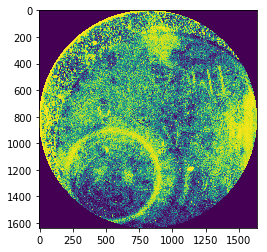

-171.50845419040766
171
<class 'numpy.ndarray'>


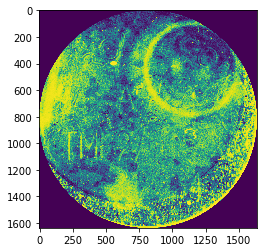

FULL-2019-04-26-121658.png.json
[1422. 1422.]
22.627416997969522 582.526394251797
727 727
cos_alpha = 0.996385269488256
sin_alpha = 0.08494936578230246


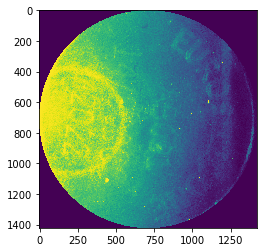

-94.87311321149451
94
<class 'numpy.ndarray'>


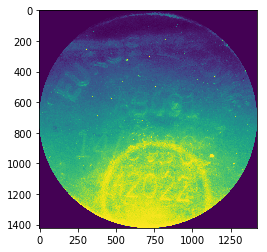

FULL-2019-04-26-122556.png.json
[1599. 1599.]
55.682133579811754 756.1881379656785
855 795
cos_alpha = 0.34489042280675075
sin_alpha = 0.9386429546191569


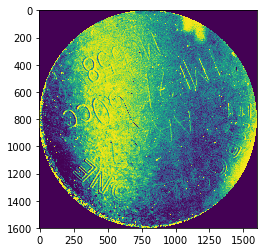

-159.82489308679732
159
<class 'numpy.ndarray'>


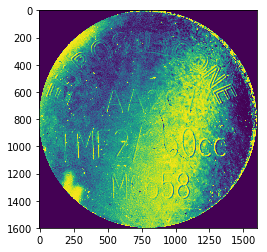

FULL-2019-04-26-145226.png.json
[1594. 1544.]
111.8257573191436 764.3768703983658
826 880
cos_alpha = -0.08053028143461022
sin_alpha = 0.9967521626623453


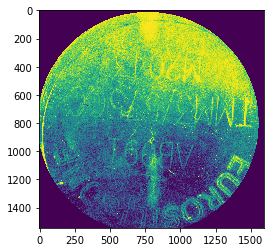

-184.61904697053095
184
<class 'numpy.ndarray'>


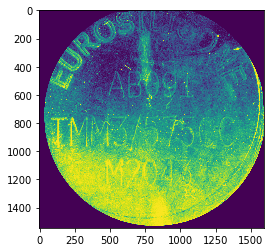

FULL-2019-04-26-134740.png.json
[1305. 1305.]
40.749233121618374 492.53070970245096
657 693
cos_alpha = 0.0018761693058026625
sin_alpha = -0.9999982399928191


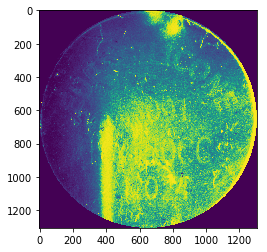

-0.10749664593943842
0
<class 'numpy.ndarray'>


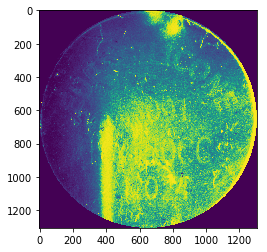

FULL-2019-04-26-140653.png.json
[1642. 1642.]
105.53672346628922 687.0997016445284
798 718
cos_alpha = -0.8830735256685163
sin_alpha = -0.4692346409456323


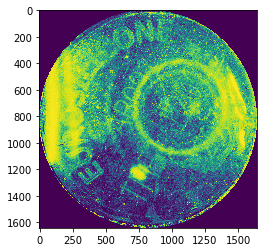

62.0153731133761
-62
<class 'numpy.ndarray'>


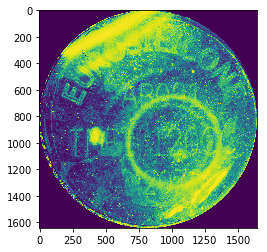

FULL-2019-04-26-135408.png.json
[1096. 1096.]
25.942243542145693 415.5490344111029
525 560
cos_alpha = 0.8800221726696685
sin_alpha = 0.4749326011233132


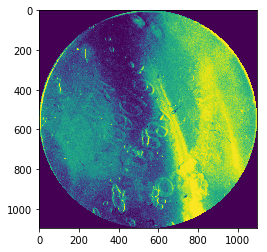

-118.35496178532405
118
<class 'numpy.ndarray'>


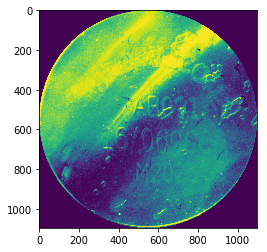

FULL-2019-04-26-140104.png.json
[1482. 1482.]
81.88406438373708 563.2566022693387
753 822
cos_alpha = 0.00776374116232472
sin_alpha = -0.999969861707424


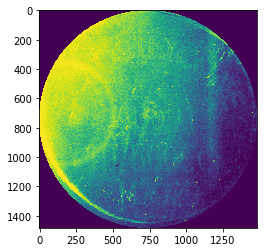

-0.44483407068863223
0
<class 'numpy.ndarray'>


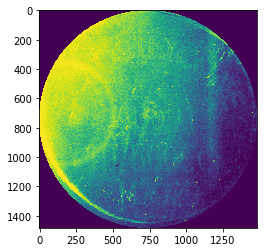

FULL-2019-04-26-150809.png.json
[1608. 1608.]
37.656340767525464 644.9806198638839
841 811
cos_alpha = -0.5328132696861393
sin_alpha = -0.8462328400897505


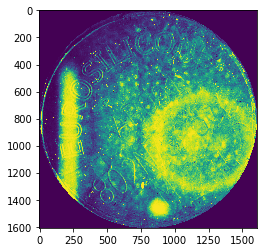

32.195733934713246
-32
<class 'numpy.ndarray'>


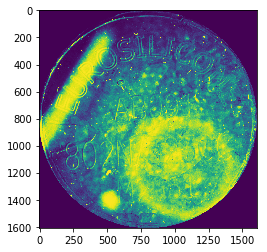

FULL-2019-04-26-152351.png.json
[1364. 1364.]
51.54609587543949 646.5616753257186
698 731
cos_alpha = 0.9554424793056309
sin_alpha = -0.2951773513301949


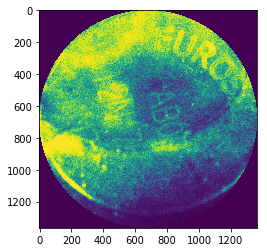

-72.83182756481803
72
<class 'numpy.ndarray'>


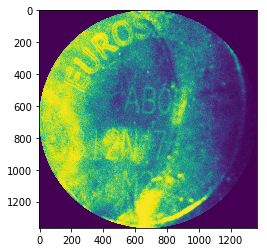

FULL-2019-04-26-152220.png.json
[1603. 1603.]
3.5355339059327378 653.5415059504637
798 801
cos_alpha = 0.9728551992982541
sin_alpha = -0.23141469529473338


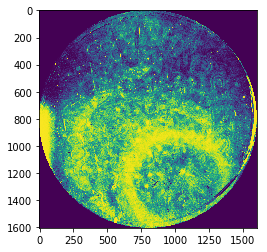

-76.61962491611098
76
<class 'numpy.ndarray'>


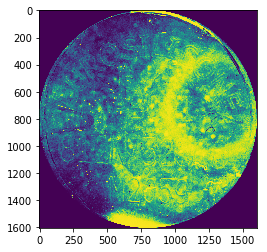

FULL-2019-04-26-143453.png.json
[1618. 1618.]
124.06449935416659 633.697877541025
813 685
cos_alpha = 0.23658898606908235
sin_alpha = 0.9716098248117933


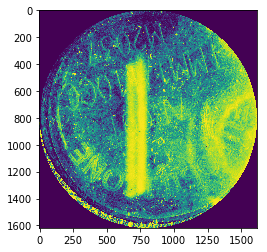

-166.31469341062905
166
<class 'numpy.ndarray'>


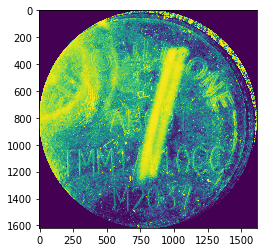

FULL-2019-04-26-135009.png.json
[1516. 1516.]
20.0 691.4860808432807
742 746
cos_alpha = 0.17564356069038672
sin_alpha = 0.9844538280630547


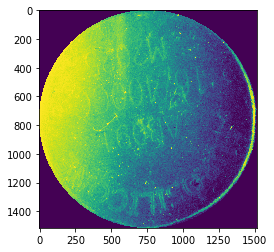

-169.88388847095976
169
<class 'numpy.ndarray'>


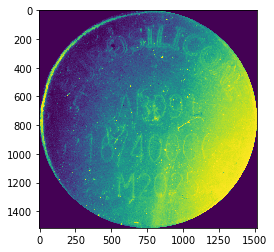

FULL-2019-04-26-121408.png.json
[1142. 1142.]
20.248456731316587 554.7765315872689
560 588
cos_alpha = 0.9131611374104113
sin_alpha = -0.4075987452425782


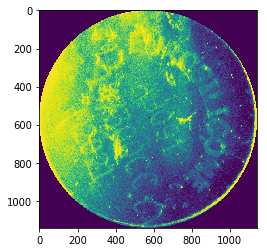

-65.94591927118238
65
<class 'numpy.ndarray'>


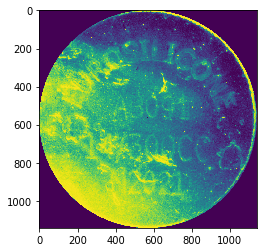

FULL-2019-04-26-134625.png.json
[1557. 1557.]
62.30971031869752 677.5105165235444
760 719
cos_alpha = -0.9544521782526365
sin_alpha = -0.2983639378825754


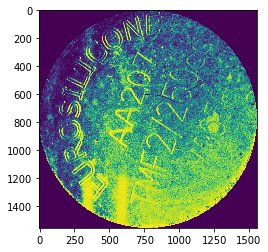

72.64063608693807
-72
<class 'numpy.ndarray'>


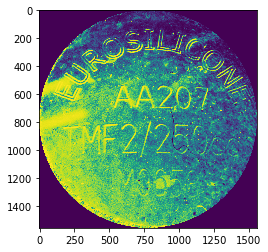

FULL-2019-04-26-144952.png.json
[1610. 1610.]
40.496913462633174 652.4078478988431
767 819
cos_alpha = 0.9981418536320619
sin_alpha = 0.06093307827405029


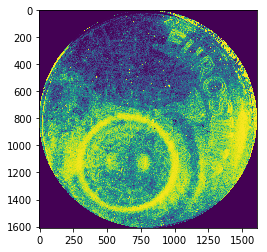

-93.49337221829721
93
<class 'numpy.ndarray'>


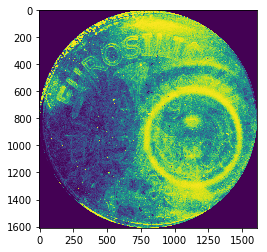

FULL-2019-04-26-161915.png.json
[1605. 1605.]
151.59980211068878 718.5321843870322
808 651
cos_alpha = 0.8110788052918877
sin_alpha = 0.5849368954052087


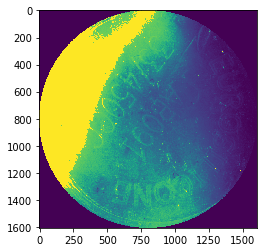

-125.79853208672142
125
<class 'numpy.ndarray'>


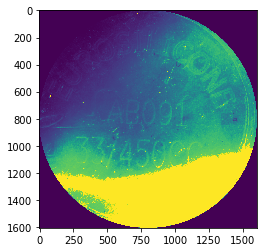

FULL-2019-04-26-145333.png.json
[1597. 1597.]
58.8430114796991 638.5001957713091
811 741
cos_alpha = -0.09040635808886145
sin_alpha = 0.995904960534442


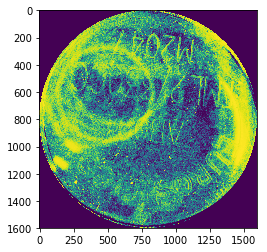

-185.18698499722544
185
<class 'numpy.ndarray'>


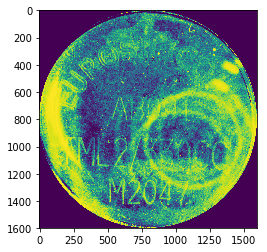

FULL-2019-04-26-143515.png.json
[1550. 1550.]
83.15046602394962 609.0164201398842
858 770
cos_alpha = -0.9860795210801401
sin_alpha = 0.1662744060472377


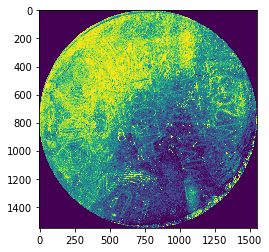

-260.4287246938965
260
<class 'numpy.ndarray'>


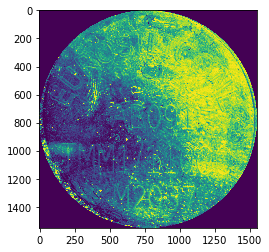

FULL-2019-04-26-160224.png.json
[1204. 1204.]
50.21951811795888 488.04610437949407
591 651
cos_alpha = 0.15052096282582353
sin_alpha = -0.9886068175720755


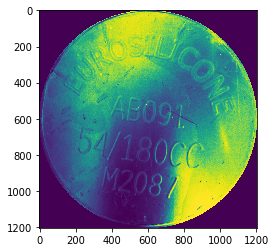

-8.65711831409018
8
<class 'numpy.ndarray'>


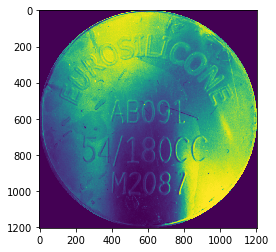

FULL-2019-04-26-160657.png.json
[1587. 1587.]
36.74914965002592 667.2649398852003
814 763
cos_alpha = -0.5147216908978676
sin_alpha = -0.8573573239433138


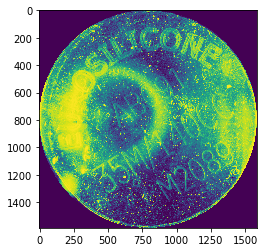

30.97885423383558
-30
<class 'numpy.ndarray'>


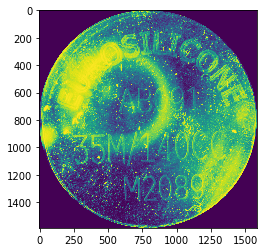

FULL-2019-04-26-144124.png.json
[1616. 1616.]
16.492422502470642 712.9691437923524
812 824
cos_alpha = 0.7507135169227553
sin_alpha = 0.6606278948920247


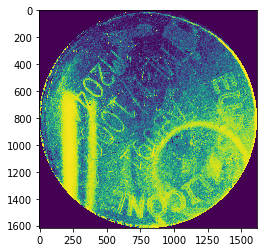

-131.34777721969368
131
<class 'numpy.ndarray'>


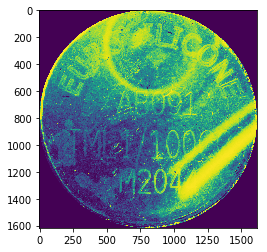

FULL-2019-04-26-160340.png.json
[1179. 1179.]
96.13792175827393 486.6359008540163
560 681
cos_alpha = 0.03112677854631327
sin_alpha = -0.999515444431615


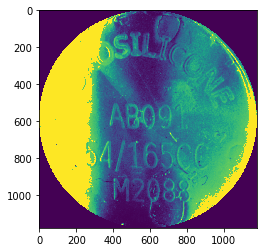

-1.7837211538558566
1
<class 'numpy.ndarray'>


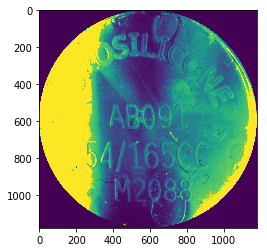

FULL-2019-04-26-161718.png.json
[1597. 1597.]
60.91387362497972 714.0675738331772
763 749
cos_alpha = -0.960258742977617
sin_alpha = 0.2791113514980122


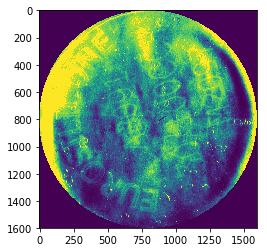

-253.7928254421154
253
<class 'numpy.ndarray'>


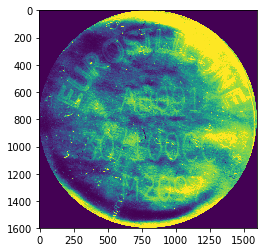

FULL-2019-04-26-121327.png.json
[2140. 2140.]
50.59644256269407 671.6918936536305
1022 1054
cos_alpha = -0.7791969377084401
sin_alpha = 0.6267791734461104


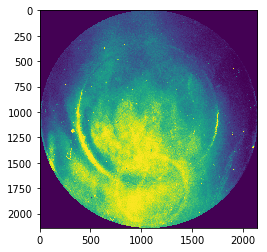

-231.18710647146145
231
<class 'numpy.ndarray'>


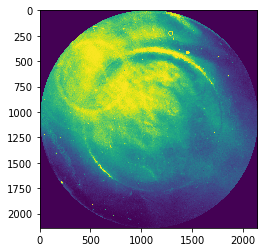

FULL-2019-04-26-153629.png.json
[1597. 1597.]
39.12160528403711 655.1034269487528
823 829
cos_alpha = 0.08934710810202845
sin_alpha = -0.9960005493340877


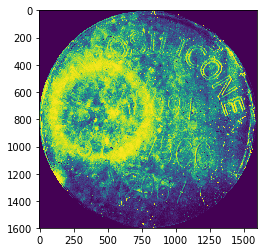

-5.126047821567939
5
<class 'numpy.ndarray'>


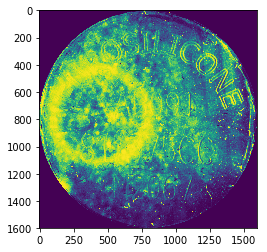

FULL-2019-04-26-154625.png.json
[1533. 1533.]
77.50161288644256 648.6497514067203
842 784
cos_alpha = 0.7661650309732135
sin_alpha = -0.6426438712956148


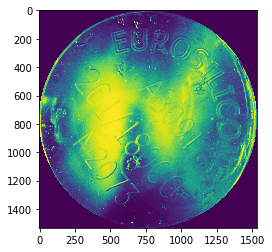

-50.01074997024763
50
<class 'numpy.ndarray'>


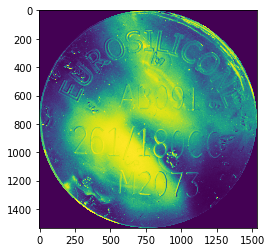

FULL-2019-04-26-145513.png.json
[1655. 1655.]
42.38513890504548 704.1225035460805
787 840
cos_alpha = -0.15633770954486692
sin_alpha = 0.98770366030215


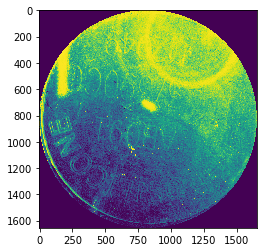

-188.99438725931654
188
<class 'numpy.ndarray'>


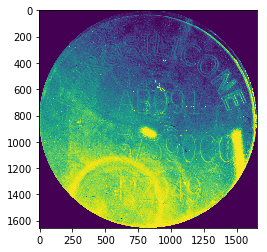

FULL-2019-04-26-140622.png.json
[1631. 1631.]
94.02393312343406 683.725456597895
790 725
cos_alpha = -0.8574929257125441
sin_alpha = -0.5144957554275265


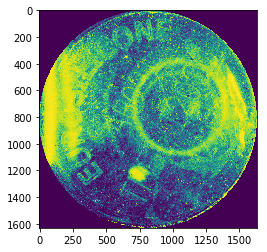

59.03624346792648
-59
<class 'numpy.ndarray'>


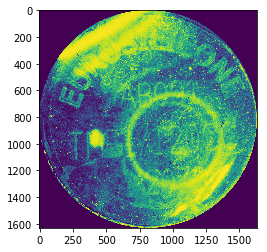

FULL-2019-04-26-161049.png.json
[1522. 1522.]
61.84658438426491 646.260009593662
704 785
cos_alpha = 0.8359465188059618
sin_alpha = -0.5488109125155891


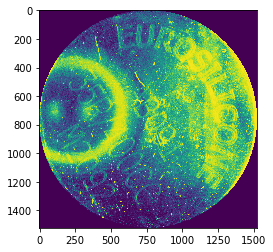

-56.714525211975676
56
<class 'numpy.ndarray'>


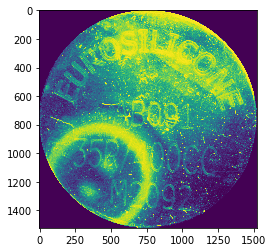

FULL-2019-04-26-153821.png.json
[1530. 1530.]
80.65358020571685 635.5171122794413
738 689
cos_alpha = 0.4275457192776476
sin_alpha = 0.9039937267079673


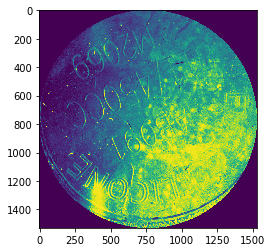

-154.68809414206504
154
<class 'numpy.ndarray'>


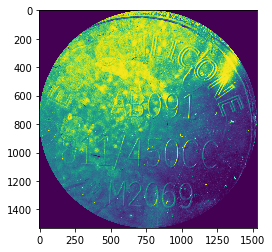

FULL-2019-04-26-135440.png.json
[1328. 1328.]
67.54257916307313 522.6327582538239
603 635
cos_alpha = 0.9956492470825592
sin_alpha = -0.09318034548086343


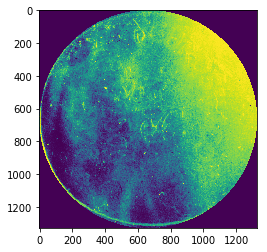

-84.65340331197426
84
<class 'numpy.ndarray'>


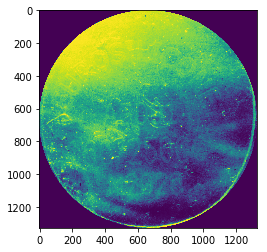

FULL-2019-04-26-153945.png.json
[1516. 1516.]
42.190046219457976 661.3115755829472
800 762
cos_alpha = -0.7482819993968338
sin_alpha = -0.6633807725421931


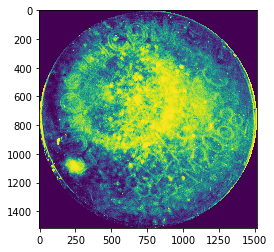

48.441777729827955
-48
<class 'numpy.ndarray'>


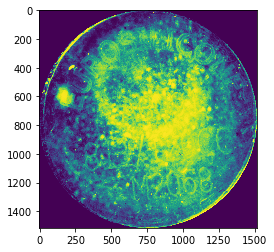

FULL-2019-04-26-155022.png.json
[1392. 1392.]
45.31004303683677 613.974755181351
738 679
cos_alpha = -0.1882654653341548
sin_alpha = 0.9821181774931743


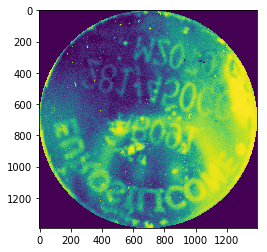

-190.85157601601978
190
<class 'numpy.ndarray'>


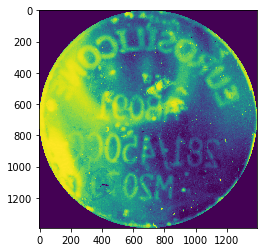

FULL-2019-04-26-143737.png.json
[1625. 1625.]
23.926972228010797 635.1051094110328
789 817
cos_alpha = 0.3692316855812872
sin_alpha = 0.9293373781156128


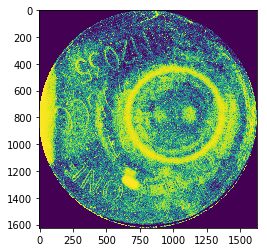

-158.3317588491321
158
<class 'numpy.ndarray'>


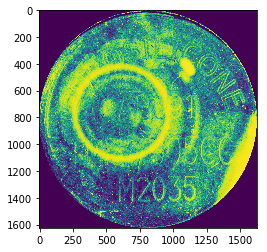

FULL-2019-04-26-135759.png.json
[1364. 1364.]
19.026297590440446 567.8468103282786
663 681
cos_alpha = 0.9986921298436662
sin_alpha = -0.05112758343909554


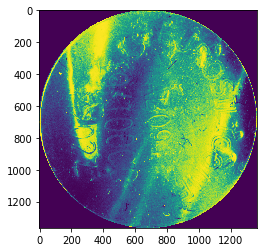

-87.06932749443304
87
<class 'numpy.ndarray'>


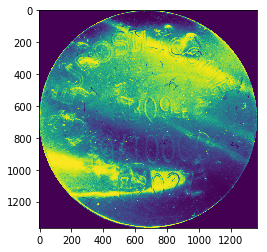

FULL-2019-04-26-161112.png.json
[1497. 1497.]
62.084619673474684 610.2249585193972
780 802
cos_alpha = -0.4507805712802584
sin_alpha = -0.892634794614373


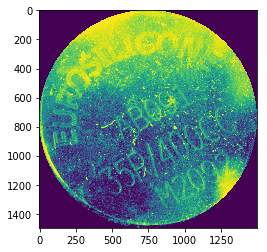

26.79377562880317
-26
<class 'numpy.ndarray'>


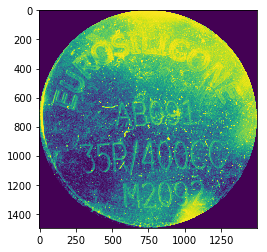

FULL-2019-04-26-134427.png.json
[1636. 1636.]
22.825424421026653 674.2291895194096
829 838
cos_alpha = -0.19494445397937524
sin_alpha = 0.9808142840837317


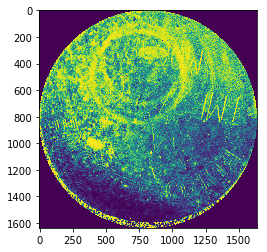

-191.24147876762646
191
<class 'numpy.ndarray'>


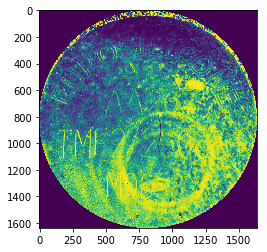

FULL-2019-04-26-155404.png.json
[1578. 1578.]
34.828149534535996 682.053516961829
811 816
cos_alpha = 0.667426868605652
sin_alpha = 0.7446753487683432


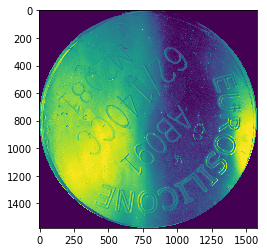

-138.13122142269202
138
<class 'numpy.ndarray'>


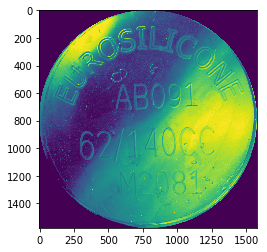

FULL-2019-04-26-121354.png.json
[555. 555.]
14.713938969562161 267.5378477898034
263 275
cos_alpha = 0.6793355866164601
sin_alpha = -0.7338277459707216


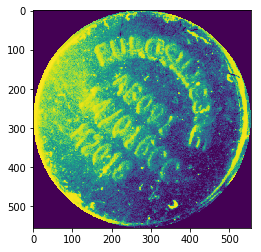

-42.79174523054074
42
<class 'numpy.ndarray'>


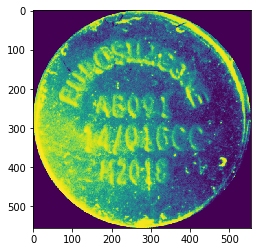

FULL-2019-04-26-153346.png.json
[1507. 1507.]
96.16912186351709 589.4527122679139
847 776
cos_alpha = -0.8758129457462516
sin_alpha = -0.4826506853442492


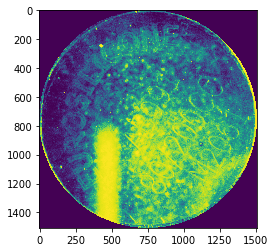

61.141333967012024
-61
<class 'numpy.ndarray'>


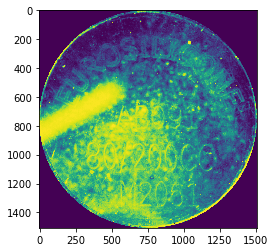

FULL-2019-04-26-134003.png.json
[1591. 1591.]
34.56153931757091 730.9093651062353
829 804
cos_alpha = 0.5681233639847499
sin_alpha = -0.8229434022426156


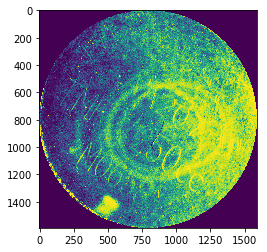

-34.619465623459746
34
<class 'numpy.ndarray'>


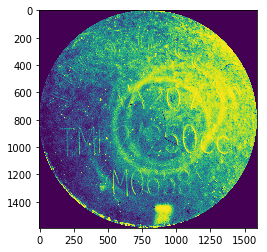

FULL-2019-04-26-153959.png.json
[1509. 1509.]
69.9035049192814 642.9840589003743
747 824
cos_alpha = 0.6793508696119862
sin_alpha = -0.7338135975555632


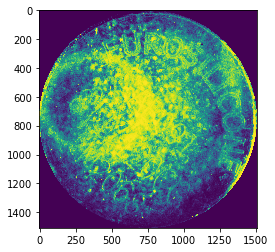

-42.792938507284816
42
<class 'numpy.ndarray'>


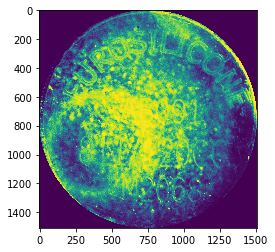

FULL-2019-04-26-160716.png.json
[1580. 1580.]
33.24154027718932 682.0593815790528
814 767
cos_alpha = -0.5004507757232203
sin_alpha = -0.8657649918297846


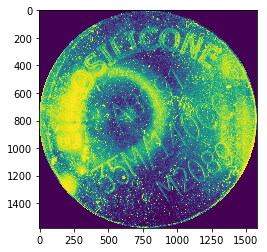

30.029827565656426
-30
<class 'numpy.ndarray'>


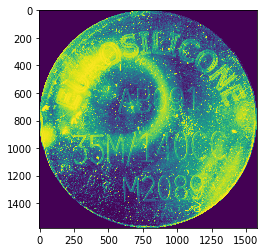

FULL-2019-04-26-154236.png.json
[1665. 1665.]
24.869660230891775 750.3615795068401
811 820
cos_alpha = 0.2514142128606229
sin_alpha = 0.967879586297631


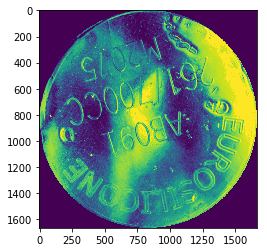

-165.43878619755282
165
<class 'numpy.ndarray'>


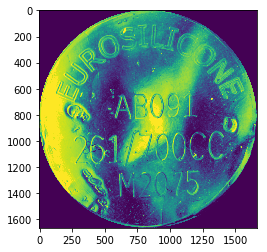

FULL-2019-04-26-152331.png.json
[1654. 1654.]
63.812224534175265 701.9294836377796
773 793
cos_alpha = 0.989160416295823
sin_alpha = -0.14683892819506145


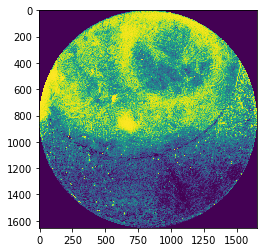

-81.55621801489579
81
<class 'numpy.ndarray'>


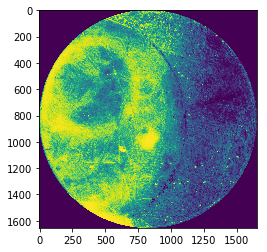

FULL-2019-04-26-150827.png.json
[1616. 1616.]
54.56189146281496 627.3452000294575
759 832
cos_alpha = 0.8624992966348719
sin_alpha = -0.5060582607806646


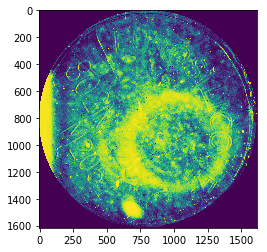

-59.59837270185296
59
<class 'numpy.ndarray'>


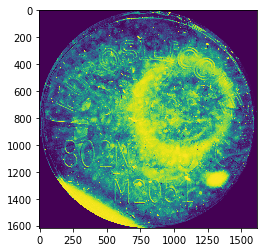

FULL-2019-04-26-143540.png.json
[1625. 1625.]
60.45246066125018 657.0254941781179
791 869
cos_alpha = 0.6950704875582147
sin_alpha = -0.7189415952117291


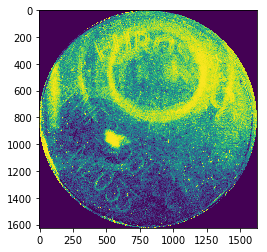

-44.03283442291219
44
<class 'numpy.ndarray'>


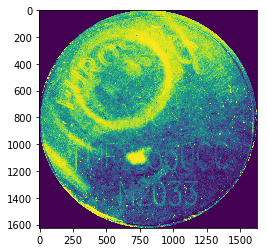

FULL-2019-04-26-154958.png.json
[1537. 1537.]
111.5100892296298 601.0445075033962
727 872
cos_alpha = 0.6640115042966362
sin_alpha = -0.7477223563340327


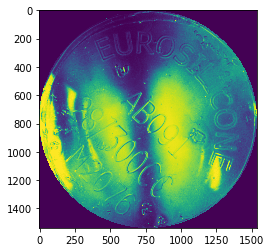

-41.606535318532885
41
<class 'numpy.ndarray'>


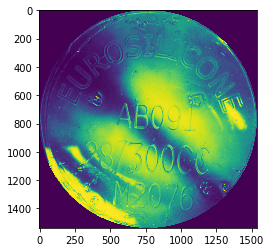

FULL-2019-04-26-142201.png.json
[1630. 1630.]
22.561028345356956 714.9671321116797
820 837
cos_alpha = 0.06929755380568912
sin_alpha = 0.9975960349943997


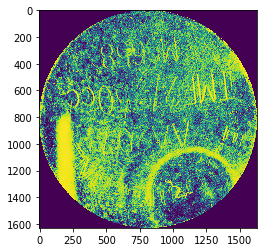

-176.0263579602834
176
<class 'numpy.ndarray'>


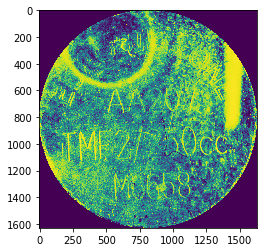

FULL-2019-04-26-155823.png.json
[1584. 1584.]
85.70297544426332 684.3741666661593
849 856
cos_alpha = -0.34710104760861754
sin_alpha = -0.9378277361802648


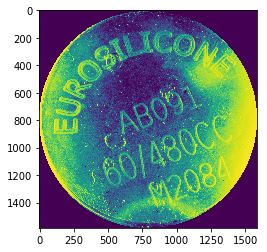

20.310104398918476
-20
<class 'numpy.ndarray'>


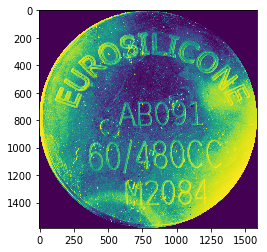

FULL-2019-04-26-161428.png.json
[1603. 1603.]
38.451267859460756 650.5801257339483
839 793
cos_alpha = -0.9025070079592574
sin_alpha = -0.43067516829326125


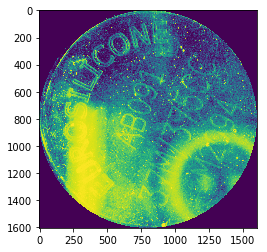

64.48958435129201
-64
<class 'numpy.ndarray'>


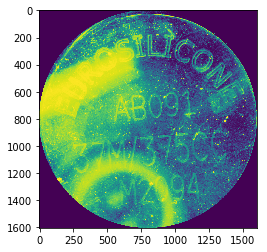

FULL-2019-04-26-151138.png.json
[1612. 1612.]
26.076809620810597 675.8143236126325
828 792
cos_alpha = 0.7733559659796023
sin_alpha = 0.6339720418786275


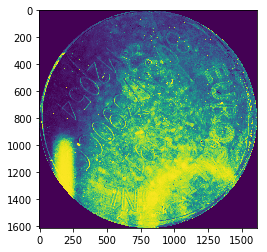

-129.34378436548403
129
<class 'numpy.ndarray'>


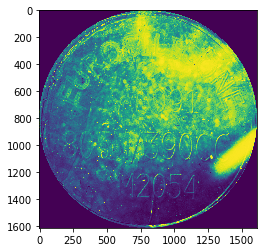

FULL-2019-04-26-150916.png.json
[1666. 1666.]
11.180339887498949 767.1271081118174
831 822
cos_alpha = -0.6145661101200883
sin_alpha = 0.7888653220238949


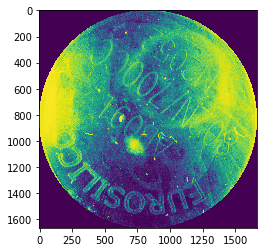

-217.92039984095126
217
<class 'numpy.ndarray'>


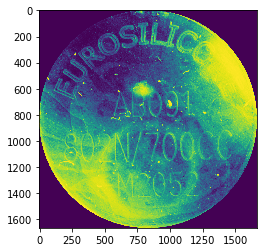

FULL-2019-04-26-154831.png.json
[1640. 1640.]
87.13208364316786 691.6104394816492
866 746
cos_alpha = -0.7717063077633545
sin_alpha = 0.6359790677044731


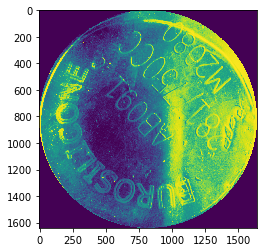

-230.5073620297529
230
<class 'numpy.ndarray'>


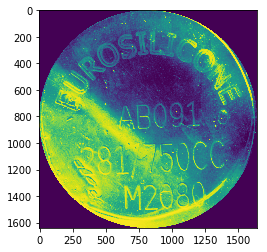

FULL-2019-04-26-153311.png.json
[1651. 1651.]
91.39201278011114 728.788378063207
736 844
cos_alpha = 0.9999970110307909
sin_alpha = 0.0024449804670679484


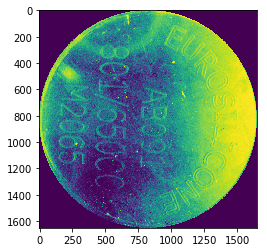

-90.14008720132702
90
<class 'numpy.ndarray'>


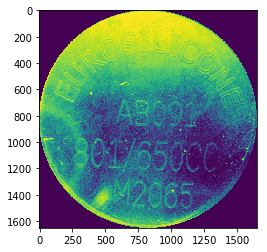

FULL-2019-04-26-155747.png.json
[1580. 1580.]
9.433981132056603 663.7740579444184
795 782
cos_alpha = -0.8104046661466184
sin_alpha = 0.5858705292876472


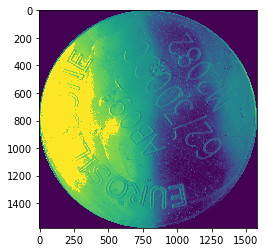

-234.1354872528466
234
<class 'numpy.ndarray'>


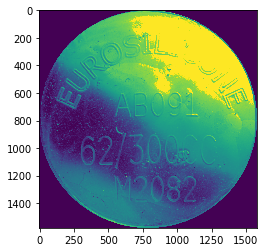

FULL-2019-04-26-160938.png.json
[1593. 1593.]
7.516648189186454 724.2682514096556
804 797
cos_alpha = 0.4422161075812725
sin_alpha = -0.896908531677377


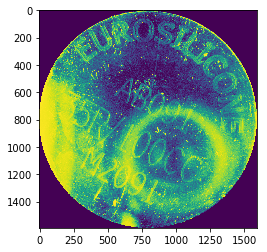

-26.24536322642273
26
<class 'numpy.ndarray'>


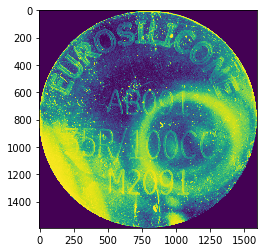

FULL-2019-04-26-153252.png.json
[1678. 1678.]
115.74541027617467 697.2868850050171
913 928
cos_alpha = -0.41324355862373335
sin_alpha = -0.9106205363684663


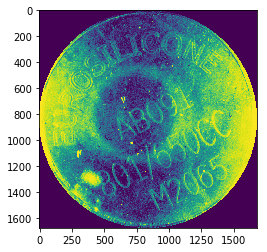

24.40875360963782
-24
<class 'numpy.ndarray'>


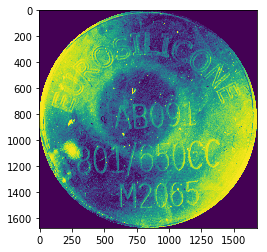

FULL-2019-04-26-160356.png.json
[1162. 1162.]
91.48223871331527 497.7881075317087
669 606
cos_alpha = -0.9959210678252969
sin_alpha = -0.09022874631579612


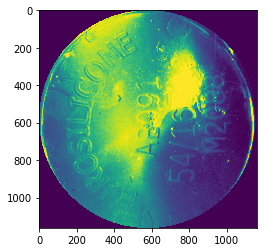

84.8232331692375
-84
<class 'numpy.ndarray'>


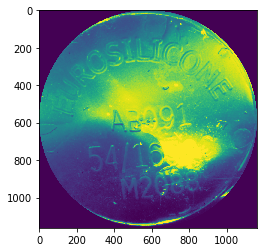

FULL-2019-04-26-134722.png.json
[1255. 1255.]
37.769034936042516 529.0675760240841
632 590
cos_alpha = 0.9653898870360534
sin_alpha = -0.26081097754603055


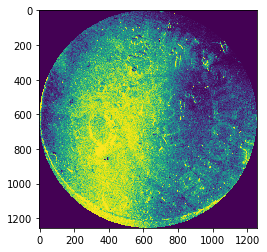

-74.88181188520112
74
<class 'numpy.ndarray'>


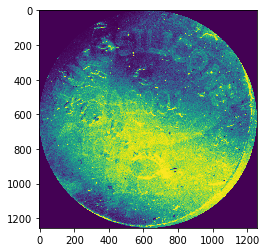

FULL-2019-04-26-160642.png.json
[1587. 1587.]
34.677081768799404 651.4311168496636
817 768
cos_alpha = -0.5043563785531963
sin_alpha = -0.8634955954796208


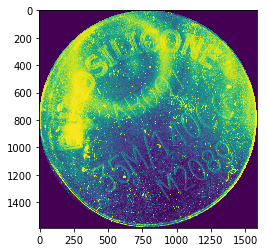

30.288636654077305
-30
<class 'numpy.ndarray'>


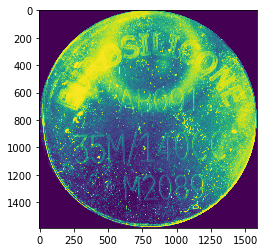

FULL-2019-04-26-140922.png.json
[1576. 1576.]
43.86342439892262 724.4784330813444
758 820
cos_alpha = 0.3689428165893898
sin_alpha = 0.9294520956386552


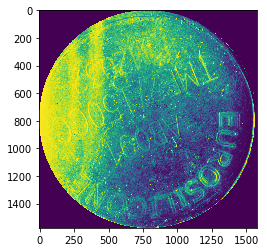

-158.34956718532976
158
<class 'numpy.ndarray'>


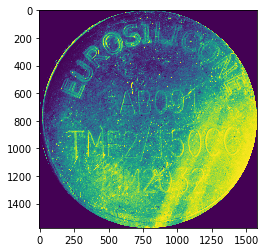

FULL-2019-04-26-140839.png.json
[1618. 1618.]
53.03772242470448 715.2684810614822
847 846
cos_alpha = 0.9136926512939104
sin_alpha = -0.4064058795976068


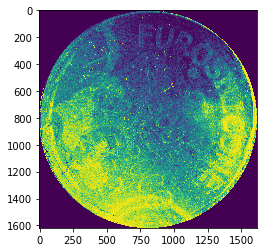

-66.02074316534649
66
<class 'numpy.ndarray'>


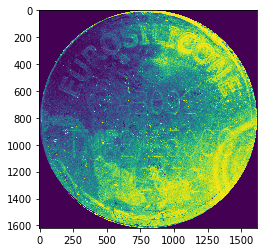

FULL-2019-04-26-160316.png.json
[1198. 1198.]
56.4003546088143 523.2446846361652
644 633
cos_alpha = -0.9994982453759637
sin_alpha = -0.03167424017036505


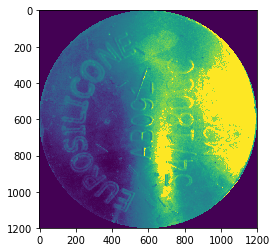

88.18489612987837
-88
<class 'numpy.ndarray'>


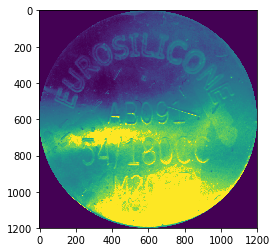

FULL-2019-04-26-144853.png.json
[1666. 1666.]
76.02631123499285 682.9128787773737
901 799
cos_alpha = -0.8973071909139297
sin_alpha = 0.441406621081008


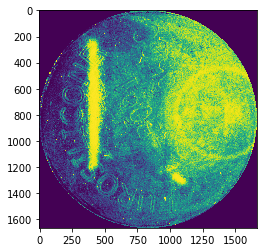

-243.80633641739055
243
<class 'numpy.ndarray'>


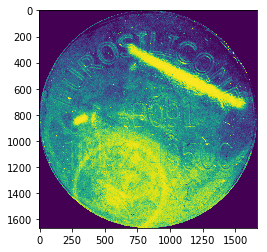

FULL-2019-04-26-161301.png.json
[1599. 1599.]
136.37631759216848 650.8444514628668
867 918
cos_alpha = -0.28734788556634544
sin_alpha = -0.9578262852211514


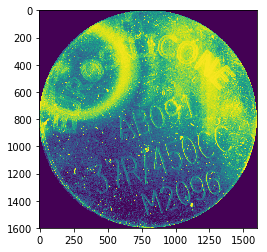

16.69924423399363
-16
<class 'numpy.ndarray'>


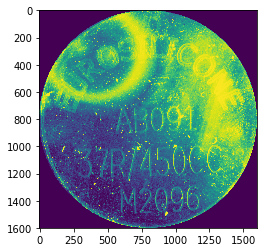

FULL-2019-04-26-140708.png.json
[1623. 1623.]
81.62413858657254 677.677283078015
885 776
cos_alpha = 0.42288546533112387
sin_alpha = -0.9061831399952653


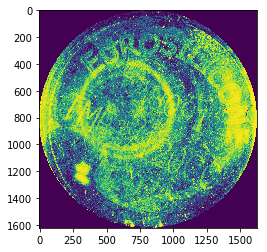

-25.016893478100013
25
<class 'numpy.ndarray'>


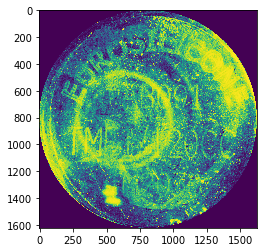

FULL-2019-04-26-152316.png.json
[1642. 1642.]
91.21403400793103 672.6254529825644
877 893
cos_alpha = -0.11350892873373886
sin_alpha = -0.9935369762106083


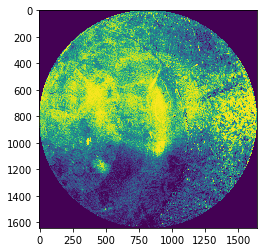

6.517629811570347
-6
<class 'numpy.ndarray'>


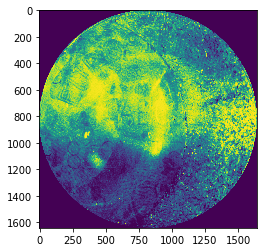

FULL-2019-04-26-160624.png.json
[1586. 1586.]
49.73932046178355 674.2647847841381
750 768
cos_alpha = -0.8107196385720814
sin_alpha = 0.585434597229745


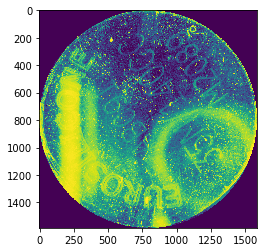

-234.16630175164542
234
<class 'numpy.ndarray'>


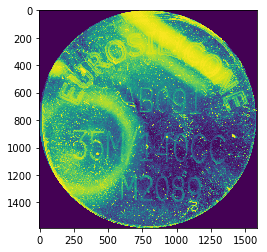

FULL-2019-04-26-135227.png.json
[995. 995.]
37.42325480232846 340.90247872375465
512 532
cos_alpha = 0.7363275207553919
sin_alpha = -0.6766252893427925


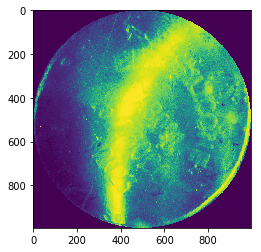

-47.41950921665632
47
<class 'numpy.ndarray'>


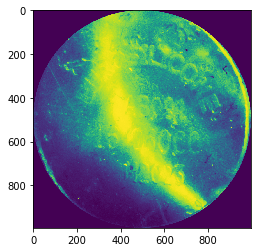

FULL-2019-04-26-154849.png.json
[1597. 1597.]
44.30011286667337 667.2124848951794
811 756
cos_alpha = -0.9597472822634074
sin_alpha = -0.28086501061542596


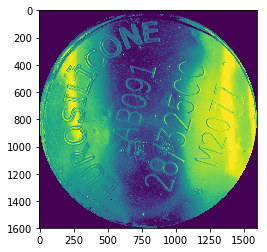

73.68816198078123
-73
<class 'numpy.ndarray'>


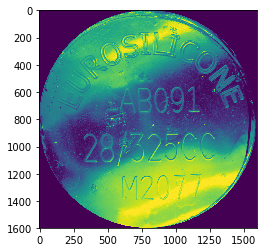

FULL-2019-04-26-160857.png.json
[1580. 1580.]
22.80350850198276 667.9558368634861
812 796
cos_alpha = -0.3741718958050005
sin_alpha = -0.9273593652892561


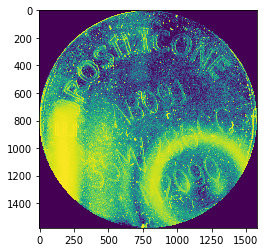

21.973140191345394
-21
<class 'numpy.ndarray'>


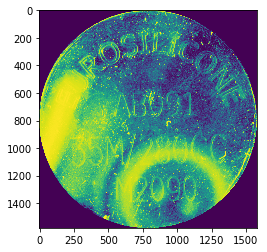

FULL-2019-04-26-155504.png.json
[1591. 1591.]
53.44623466625128 695.7460025037873
846 813
cos_alpha = -0.612254968981374
sin_alpha = -0.7906603904064101


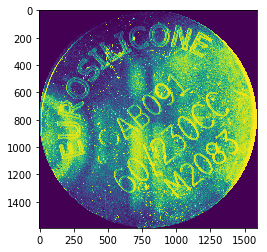

37.75273110651233
-37
<class 'numpy.ndarray'>


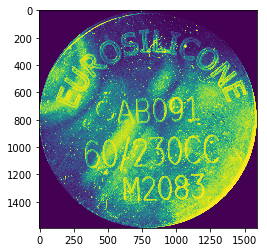

FULL-2019-04-26-141537.png.json
[1625. 1625.]
39.5790348543266 652.7346321438752
852 810
cos_alpha = -0.8329453304951506
sin_alpha = 0.5533552894897854


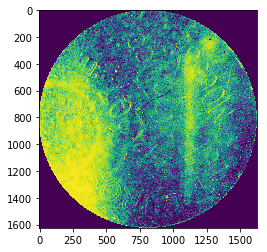

-236.40249423438905
236
<class 'numpy.ndarray'>


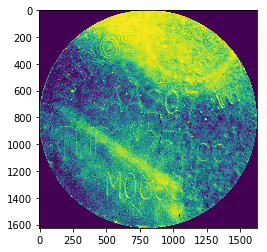

FULL-2019-04-26-145956.png.json
[1604. 1604.]
39.44616584663204 708.7037462861333
768 782
cos_alpha = 0.3585257365845993
sin_alpha = 0.9335198424278246


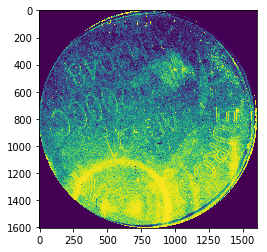

-158.99031596584004
158
<class 'numpy.ndarray'>


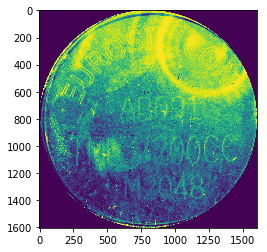

FULL-2019-04-26-144803.png.json
[1610. 1610.]
79.05694150420949 690.5186456570162
880 830
cos_alpha = 0.8561037853289943
sin_alpha = -0.5168039364646589


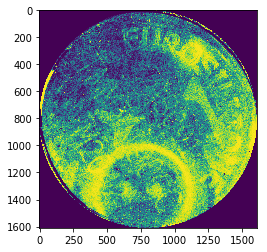

-58.88189098703587
58
<class 'numpy.ndarray'>


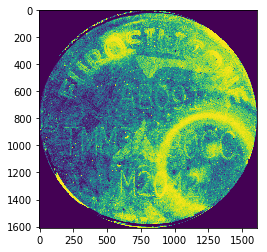

FULL-2019-04-26-144244.png.json
[1610. 1610.]
11.313708498984761 630.3031016899727
797 797
cos_alpha = -0.8001908599117715
sin_alpha = 0.5997454357589223


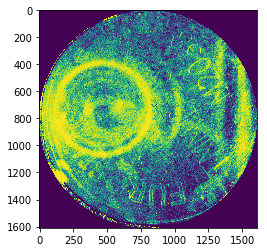

-233.14833200022017
233
<class 'numpy.ndarray'>


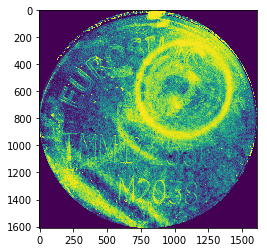

FULL-2019-04-26-155135.png.json
[1542. 1542.]
36.40054944640259 635.9119435896765
736 761
cos_alpha = 0.9865143032411716
sin_alpha = 0.163675072935941


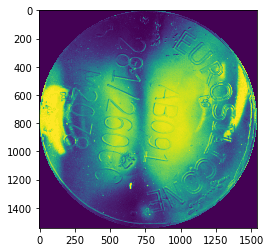

-99.4202754106472
99
<class 'numpy.ndarray'>


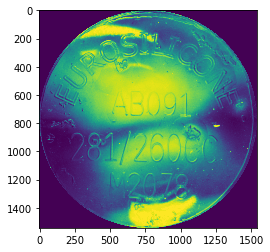

FULL-2019-04-26-140811.png.json
[1612. 1612.]
22.20360331117452 706.9285678199743
828 809
cos_alpha = 0.9309635038537938
sin_alpha = -0.3651122491676597


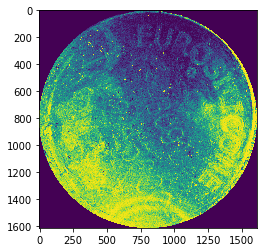

-68.5855091289652
68
<class 'numpy.ndarray'>


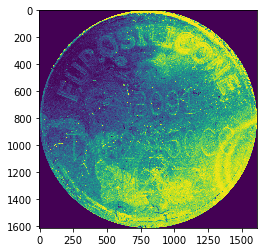

FULL-2019-04-26-150032.png.json
[1603. 1603.]
39.223717314910374 685.2769513123873
794 840
cos_alpha = 0.9427016650662362
sin_alpha = -0.33363688447374323


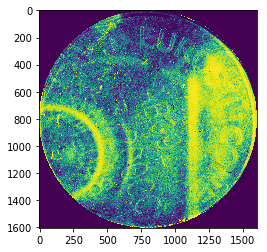

-70.51033110212869
70
<class 'numpy.ndarray'>


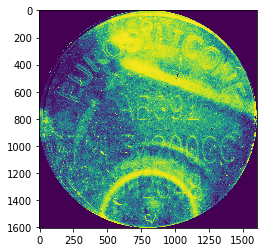

FULL-2019-04-26-153537.png.json
[1574. 1574.]
38.48376280978771 672.5957180952016
752 803
cos_alpha = 0.9098842469701182
sin_alpha = -0.41486221461543255


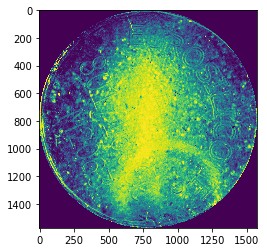

-65.48936021767226
65
<class 'numpy.ndarray'>


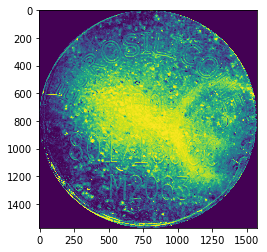

FULL-2019-04-26-154336.png.json
[1499. 1499.]
49.42165517260627 625.5017985585653
728 794
cos_alpha = 0.7778008255412783
sin_alpha = -0.6285108398327796


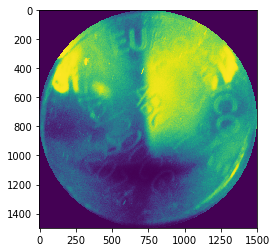

-51.05965974428716
51
<class 'numpy.ndarray'>


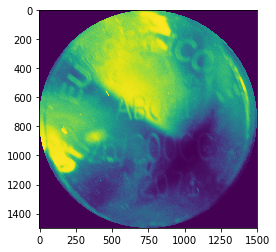

FULL-2019-04-26-141247.png.json
[1631. 1631.]
29.53811097548386 682.7990187456335
840 799
cos_alpha = -0.8226467713916104
sin_alpha = 0.5685528027535873


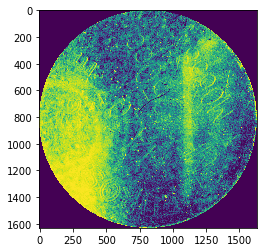

-235.35063017700216
235
<class 'numpy.ndarray'>


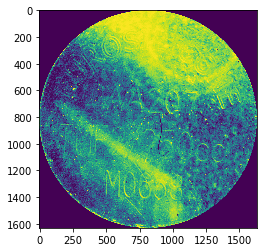

FULL-2019-04-26-121832.png.json
[882. 882.]
30.23243291566195 374.78660595063957
466 458
cos_alpha = 0.9649588911840468
sin_alpha = -0.2624011019886443


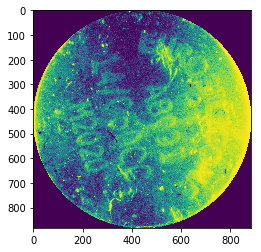

-74.7874171313795
74
<class 'numpy.ndarray'>


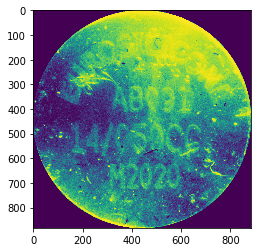

FULL-2019-04-26-121459.png.json
[1181. 1181.]
10.700467279516348 558.4089003588679
582 597
cos_alpha = 0.8593480497115878
sin_alpha = -0.5113911706872639


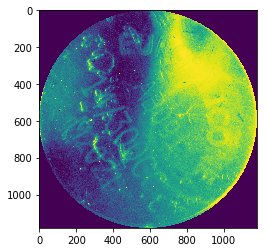

-59.24346057354782
59
<class 'numpy.ndarray'>


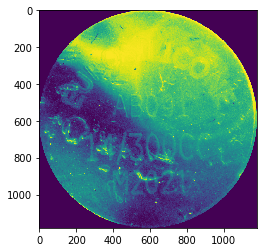

FULL-2019-04-26-145435.png.json
[1672. 1672.]
66.18912297349165 649.5690879344552
777 866
cos_alpha = 0.9904763134791096
sin_alpha = -0.13768323222830176


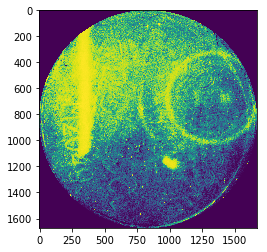

-82.08619302422478
82
<class 'numpy.ndarray'>


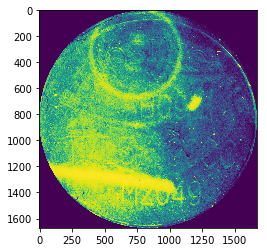

In [45]:
JSON_PATH = '../ds/ann/'  

filenames = os.listdir(JSON_PATH)

for filename in filenames:
    
    print(filename)
    
    #Read JSON data into the datastore variable
    if filename:
        with open(JSON_PATH + filename, 'r') as f:
            x = json.load(f)
    x1 = int(x['objects'][0]['points']['exterior'][0][0])
    y1 = int(x['objects'][0]['points']['exterior'][0][1])
    x2 = int(x['objects'][0]['points']['exterior'][1][0])
    y2 = int(x['objects'][0]['points']['exterior'][1][1])
    
    size = np.zeros(2)
    size[0] = x['size']['width']
    size[1] = x['size']['height']
    print(size)
    im_name = filename[:-5]
    img = cv2.imread('../ds/img/'+im_name)
    img2 = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
        
    
    #Check points role ( is it the center point or the other ?)
    xcenter = size[0]/2
    ycenter = size[1]/2

    dist1 = np.sqrt((ycenter-y1)**2+(xcenter-x1)**2)
    dist2 = np.sqrt((ycenter-y2)**2+(xcenter-x2)**2)
    print(dist1,dist2)
    
    if dist1 > dist2:
        xc = x2
        yc = y2
        x_bord = x1
        y_bord = y1
        
    else:
        xc = x1
        yc = y1
        xb = x2
        yb = y2
    print(xc,yc)
    
    # Get the angle
    
    a = xb - xc
    b = yb - yc
    c = np.sqrt((yb-yc)**2+(xb-xc)**2)
    
    cos_alpha = a/c
    sin_alpha = b/c
    print('cos_alpha =', cos_alpha)
    print('sin_alpha =', sin_alpha)
    
    #alpha = math.acos(cos_alpha)

    if sin_alpha>=0:
        alpha = -1*(math.acos(cos_alpha) + np.pi/2)
    else:
        alpha =(math.acos(cos_alpha) - np.pi/2)
        
    plt.imshow(img2)
    plt.show()
    
    # Petits chagements pour que ça colle dans ce cas là
    #alpha = -1*(alpha+np.pi/2)
    print(math.degrees(alpha))
    
    #img3 = rotateImage(img2,-1*math.degrees(alpha))
    
    alpha_correc = int(-1*math.degrees(alpha))
    print(alpha_correc)
    img3 = imutils.rotate(img2,alpha_correc)
    print(type(img3))
    plt.imshow(img3)
    plt.show()

    
    img4 =cv2.resize(img3, (300, 300))
    final = img4

    #final_im.save('./full_size/chip_test/'+im_name)
    cv2.imwrite( '../ds/img_corr_resized/'+im_name, final )